In [1]:
############# Mountiong Google Drive and Changing Working Directory PATH to Dataset Directory PATH ##################

from google.colab import drive
drive.mount('/content/drive')


Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [2]:
!unzip "/content/drive/MyDrive/Bone_Fracture/Bone_Fracture.zip"

Archive:  /content/drive/MyDrive/Bone_Fracture/Bone_Fracture.zip
   creating: Bone_Fracture/
   creating: Bone_Fracture/Bone_Fracture/
   creating: Bone_Fracture/Bone_Fracture/Negative/
  inflating: Bone_Fracture/Bone_Fracture/Negative/image (1).png  
  inflating: Bone_Fracture/Bone_Fracture/Negative/image (1009).png  
  inflating: Bone_Fracture/Bone_Fracture/Negative/image (1047).png  
  inflating: Bone_Fracture/Bone_Fracture/Negative/image (1061).png  
  inflating: Bone_Fracture/Bone_Fracture/Negative/image (1197).png  
  inflating: Bone_Fracture/Bone_Fracture/Negative/image (1198).png  
  inflating: Bone_Fracture/Bone_Fracture/Negative/image (1199).png  
  inflating: Bone_Fracture/Bone_Fracture/Negative/image (1214).png  
  inflating: Bone_Fracture/Bone_Fracture/Negative/image (1234).png  
  inflating: Bone_Fracture/Bone_Fracture/Negative/image (1235).png  
  inflating: Bone_Fracture/Bone_Fracture/Negative/image (1236).png  
  inflating: Bone_Fracture/Bone_Fracture/Negative/image (1

In [3]:
directory_path = "/content/Bone_Fracture"

################# Changing the Working Directory Path ################## 
import os
os.chdir(directory_path)
!ls

Bone_Fracture  train_test_split


In [4]:
!pwd

/content/Bone_Fracture


In [5]:
import os
os.chdir("{}/Bone_Fracture/Positive".format(directory_path))
!ls


'04085901 masked.png'	  '2018-315AP masked.png'   '2018-672AP masked.png'
'100a masked.png'	  '2018 315 L masked.png'   '2018-672L masked.png'
'100 masked.png'	  '2018 316 AP masked.png'  '2018-675AP masked.png'
'102a masked.png'	  '2018-316AP masked.png'   '2018-676AP masked.png'
'102 masked.png'	  '2018 316 L masked.png'   '2018-676L masked.png'
'103a masked.png'	  '2018-316L masked.png'    '2018-677L masked.png'
'104 masked.png'	  '2018 317 AP masked.png'  '2018-679AP masked.png'
'105a masked.png'	  '2018-317AP masked.png'   '2018-679L masked.png'
'105 masked.png'	  '2018 317 L masked.png'   '2018 67 AP masked.png'
'106a masked.png'	  '2018 318 AP masked.png'  '2018-67AP masked.png'
'107a masked.png'	  '2018-318AP masked.png'   '2018 67 L masked.png'
'107 masked.png'	  '2018-319AP masked.png'   '2018-681AP masked.png'
'108a masked.png'	  '2018 319 L masked.png'   '2018-682L masked.png'
'108 masked.png'	  '2018-31AP masked.png'    '2018-683AP masked.png'
'109a masked.png'	  '2018 31 

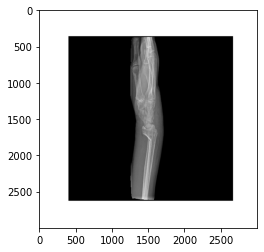

 Actual Image Shape is : (3000, 3000, 4)


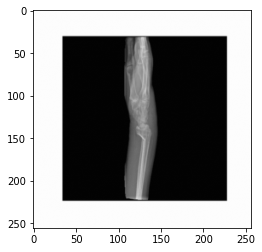

 New Resized Image Shape is : (256, 256, 4)


In [6]:
#################### Showing One Image of Bone and its resized image as well ##################

import numpy as np
import cv2
from scipy import ndimage
from skimage import io
from skimage.transform import rotate
from matplotlib import pyplot as plt
from google.colab.patches import cv2_imshow
from skimage.color import rgb2hsv
import glob
import os
from skimage.transform import resize

import os
os.chdir("{}/Bone_Fracture/Positive".format(directory_path))

############# Code for Cropping, Rotating and 1 Image ###################
tmp_path = "100a masked.png" 
tmp_img = io.imread(tmp_path)
plt.imshow(tmp_img)
plt.show()
print(" Actual Image Shape is :", tmp_img.shape)

resized_img  = resize(tmp_img, (256,256,4), anti_aliasing=True, order=1)
plt.imshow(resized_img)
plt.show()

print(" New Resized Image Shape is :", resized_img.shape)


In [7]:
#################### Making a Numpy Array from All Bone images to train the network ####################


all_bone_images_directory_path = "{}/Bone_Fracture/Positive".format(directory_path)
all_bone_images_paths = glob.glob('{}/*.png'.format(all_bone_images_directory_path) )
print(len(all_bone_images_paths))


bone_images_array_data = np.zeros((len(all_bone_images_paths[:300]), 256,256,4))

for i, tmp_img_path in enumerate(all_bone_images_paths[:300]):

  print("Adding {} Bone Image to Numpy Array".format ( os.path.basename(tmp_img_path)) )
  try:
    tmp_img = io.imread(tmp_img_path)
  except:
    continue

  tmp_img_resized = resize(tmp_img, (256, 256,4))

  bone_images_array_data[i,] = tmp_img_resized

np.save("bone_images_array_data.npy",bone_images_array_data)

1976
Adding 2018 182 L masked.png Bone Image to Numpy Array
Adding 316 masked.png Bone Image to Numpy Array
Adding 2018 454 L masked.png Bone Image to Numpy Array
Adding 2018 89 L masked.png Bone Image to Numpy Array
Adding 2018-281AP masked.png Bone Image to Numpy Array
Adding 2018 156 AP masked.png Bone Image to Numpy Array
Adding 35a masked.png Bone Image to Numpy Array
Adding 243a masked.png Bone Image to Numpy Array
Adding 65 masked.png Bone Image to Numpy Array
Adding 211 masked.png Bone Image to Numpy Array
Adding 2018-434L masked.png Bone Image to Numpy Array
Adding 2019-252L masked.png Bone Image to Numpy Array
Adding 2018 200 L masked.png Bone Image to Numpy Array
Adding 112a masked.png Bone Image to Numpy Array
Adding 33a masked.png Bone Image to Numpy Array
Adding 2019-179AP masked.png Bone Image to Numpy Array
Adding 2018 123 L masked.png Bone Image to Numpy Array
Adding 341A masked.png Bone Image to Numpy Array
Adding 283 masked.png Bone Image to Numpy Array
Adding 2018-4

In [8]:
##################### Defining Auto-Encoder Architecture ###################################

import numpy as np
import tensorflow as tf
import matplotlib.pyplot as plt

from tensorflow.keras import layers
#from tensorflow.keras.datasets import mnist
from tensorflow.keras.models import Model

input = layers.Input(shape=(256, 256, 4))

################## Making U-Net Like Covolutional Auto-Encoder Architecture ###################

###### Defining Encoder Model Architecture ################ 
down_Sampling_Stage_1 = layers.Conv2D(32, (3, 3), activation="relu", padding="same")(input)
x1 = layers.MaxPooling2D((2, 2), padding="same")(down_Sampling_Stage_1)
x2 = layers.BatchNormalization()(x1)
down_Sampling_Stage_2 = layers.Conv2D(64, (3, 3), activation="relu", padding="same")(x2)
x3 = layers.MaxPooling2D((2, 2), padding="same")(down_Sampling_Stage_2)
x4 = layers.BatchNormalization()(x3)
down_Sampling_Stage_3 = layers.Conv2D(128, (3, 3), activation="relu", padding="same")(x4)
x5 = layers.MaxPooling2D((2, 2), padding="same")(down_Sampling_Stage_3)
x6 = layers.BatchNormalization()(x5)
down_Sampling_Stage_4 = layers.Conv2D(256, (3, 3), activation="relu", padding="same")(x6)
x7 = layers.MaxPooling2D((2, 2), padding="same")(down_Sampling_Stage_4)
x8 = layers.BatchNormalization()(x7)
down_Sampling_Stage_5 = layers.Conv2D(512, (3, 3), activation="relu", padding="same")(x8)
x9 = layers.MaxPooling2D((2, 2), padding="same")(down_Sampling_Stage_5)
x10 = layers.BatchNormalization()(x9)
down_Sampling_Stage_6 = layers.Conv2D(1024, (3, 3), activation="relu", padding="same")(x10)
x11 = layers.MaxPooling2D((2, 2), padding="same")(down_Sampling_Stage_6)

###### Defining Decoder Model Architecture ################ 
x12 = layers.Conv2DTranspose(1024, (3, 3), strides=2, activation="relu", padding="same")(x11)
x13 = layers.BatchNormalization()(x12)
x14 = layers.Concatenate()([x13, down_Sampling_Stage_6])
x15 = layers.Conv2DTranspose(512, (3, 3), strides=2, activation="relu", padding="same")(x14)
x16 = layers.BatchNormalization()(x15)
x17 = layers.Concatenate()([x16, down_Sampling_Stage_5])
x18 = layers.Conv2DTranspose(256, (3, 3), strides=2, activation="relu", padding="same")(x17)
x19 = layers.BatchNormalization()(x18)
x20 = layers.Concatenate()([x19, down_Sampling_Stage_4])
x21 = layers.Conv2DTranspose(128, (3, 3), strides=2, activation="relu", padding="same")(x20)
x22 = layers.BatchNormalization()(x21)
x23 = layers.Concatenate()([x22, down_Sampling_Stage_3])
x24 = layers.Conv2DTranspose(64, (3, 3), strides=2, activation="relu", padding="same")(x23)
x25 = layers.BatchNormalization()(x24)
x26 = layers.Concatenate()([x25, down_Sampling_Stage_2])
x27 = layers.Conv2DTranspose(32, (3, 3), strides=2, activation="relu", padding="same")(x26)
x28 = layers.BatchNormalization()(x27)
x29 = layers.Concatenate()([x28, down_Sampling_Stage_1])
x30 = layers.Conv2D(4, (3, 3), activation="sigmoid", padding="same")(x29)

# Autoencoder
autoencoder = Model(input, x30)
autoencoder.compile(optimizer="adam", loss="mse")
print("Showing Auto-Encoder Model Architecture: ")
print(autoencoder.summary())


Showing Auto-Encoder Model Architecture: 
Model: "model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 256, 256, 4  0           []                               
                                )]                                                                
                                                                                                  
 conv2d (Conv2D)                (None, 256, 256, 32  1184        ['input_1[0][0]']                
                                )                                                                 
                                                                                                  
 max_pooling2d (MaxPooling2D)   (None, 128, 128, 32  0           ['conv2d[0][0]']                 
                                )                   

Epoch 1/20
26/26 - 21s - loss: 0.0329 - val_loss: 0.0506 - 21s/epoch - 821ms/step
Epoch 2/20
26/26 - 4s - loss: 7.8110e-04 - val_loss: 0.0606 - 4s/epoch - 161ms/step
Epoch 3/20
26/26 - 4s - loss: 4.6790e-04 - val_loss: 0.0479 - 4s/epoch - 161ms/step
Epoch 4/20
26/26 - 4s - loss: 4.1653e-04 - val_loss: 0.0341 - 4s/epoch - 161ms/step
Epoch 5/20
26/26 - 4s - loss: 4.6950e-04 - val_loss: 0.0223 - 4s/epoch - 161ms/step
Epoch 6/20
26/26 - 4s - loss: 3.3310e-04 - val_loss: 0.0156 - 4s/epoch - 162ms/step
Epoch 7/20
26/26 - 4s - loss: 2.7266e-04 - val_loss: 0.0111 - 4s/epoch - 163ms/step
Epoch 8/20
26/26 - 4s - loss: 2.6818e-04 - val_loss: 0.0067 - 4s/epoch - 165ms/step
Epoch 9/20
26/26 - 4s - loss: 2.3610e-04 - val_loss: 0.0055 - 4s/epoch - 163ms/step
Epoch 10/20
26/26 - 4s - loss: 1.9707e-04 - val_loss: 0.0047 - 4s/epoch - 164ms/step
Epoch 11/20
26/26 - 4s - loss: 2.5388e-04 - val_loss: 0.0032 - 4s/epoch - 165ms/step
Epoch 12/20
26/26 - 4s - loss: 1.7751e-04 - val_loss: 0.0027 - 4s/epoch - 16

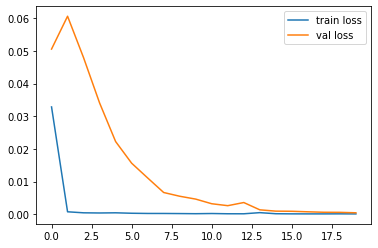

In [9]:
##################### Training Auto-Encoder Model with Given Dataset Images ############################

from sklearn.model_selection import train_test_split
from matplotlib import pyplot as plt

X_train, X_test, y_train, y_test = train_test_split(bone_images_array_data, bone_images_array_data, test_size=0.33, random_state=42)

history = autoencoder.fit(X_train,y_train,
                          epochs=20, batch_size=8,
                          validation_data=(X_test, y_test),
                          verbose = 2)

model_path = "{}/autoencoder.h5".format(directory_path)
print("Saving Autoencoder Model for Later Use..")
autoencoder.save(model_path)
print("Autoencoder Model Saved.")


print("Showing Training and Validation Losses Graph:")
plt.plot(history.history['loss'], label='train loss')
plt.plot(history.history['val_loss'], label='val loss')
plt.legend()
plt.show()



In [10]:
################## Findind Test Accuracy on Positive Bone Images ###############
import keras 
import tensorflow as tf

########## Getting Predictions from trained Auto-Encoder Model ######################

output = autoencoder.predict(X_test)


############# Fiding the loss Between Actual Positive Bone Images and Predicted Bone Images #################
mse_loses= tf.keras.metrics.mean_squared_error(y_test, output)
print(mse_loses.shape)
mse_loses= tf.reduce_sum(mse_loses, axis=-1)
mse_loses= tf.reduce_sum(mse_loses, axis=-1)
print("Individual Losses Between Actual Positive Bone Images and Predicted Bone Images: ", mse_loses)

mse_loss_threshod = 50

predicted_class = mse_loses <= mse_loss_threshod

actual_test_labels = np.ones(y_test.shape[0])

from sklearn.metrics import accuracy_score

model_accuracy = accuracy_score(actual_test_labels, predicted_class)
print("Auto-Encoder Model Accuracy on Test Images is : ", model_accuracy, " OR ", model_accuracy*100, "%" )

(99, 256, 256)
Individual Losses Between Actual Positive Bone Images and Predicted Bone Images:  tf.Tensor(
[31.335045 18.894688 23.541204 25.68922  26.140095 47.08596  27.042334
 28.425713 32.378654 33.52243  37.25219  21.67473  24.2401   30.873156
 27.645702 23.099016 31.334183 44.70977  20.694237 21.118462 36.528072
 35.300117 47.311726 28.905613 33.330803 33.428402 23.877357 27.853168
 30.511467 36.951557 32.279675 23.425276 47.250477 43.53382  30.646063
 52.87162  24.781597 23.238823 40.61582  30.545689 39.099247 31.2519
 33.801933 39.627995 38.80223  26.481369 16.749748 38.438984 39.546364
 45.53714  18.295677 21.413078 23.985348 23.471794 21.559494 25.159985
 30.972427 30.9001   21.759298 51.70202  27.531067 40.68673  19.7558
 35.668945 33.127705 20.612537 31.944933 20.014294 30.435818 18.987299
 36.68663  25.493969 28.447573 33.072865 23.688873 31.37917  22.18686
 30.964125 36.622635 26.572666 34.01555  33.671165 40.65162  23.570932
 27.55729  27.099117 25.797352 41.957767 38.4

In [11]:
def dice_coeff(y_true, y_pred):
    smooth = 1.
    # Flatten
    y_true = tf.cast (y_true, dtype= tf.float64)
    y_pred = tf.cast (y_pred, dtype= tf.float64)
    y_true_f = tf.reshape(y_true, [-1])
    y_pred_f = tf.reshape(y_pred, [-1])
    intersection = tf.reduce_sum(y_true_f * y_pred_f)
    score = (2. * intersection + smooth) / (tf.reduce_sum(y_true_f) + tf.reduce_sum(y_pred_f) + smooth)
    return score

Actual Image: 


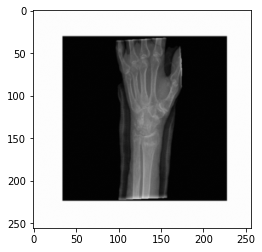

Predicted Image: 


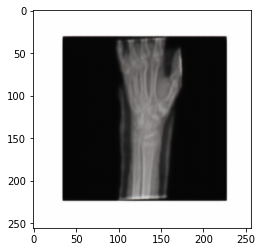

Dice Coefficient Values between predicted and actual Maks is:  tf.Tensor(0.9465551288984034, shape=(), dtype=float64)
Actual Image: 


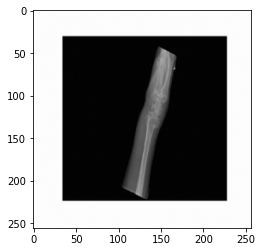

Predicted Image: 


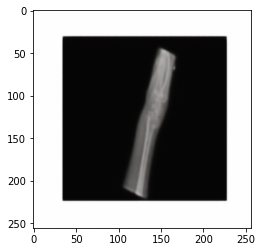

Dice Coefficient Values between predicted and actual Maks is:  tf.Tensor(0.9465551288984034, shape=(), dtype=float64)
Actual Image: 


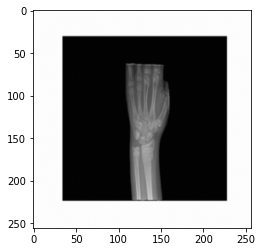

Predicted Image: 


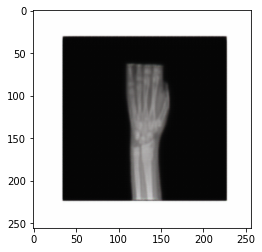

Dice Coefficient Values between predicted and actual Maks is:  tf.Tensor(0.9465551288984034, shape=(), dtype=float64)
Actual Image: 


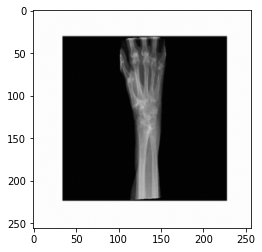

Predicted Image: 


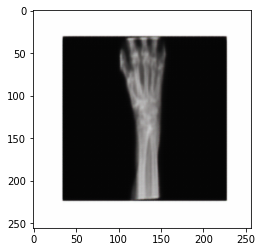

Dice Coefficient Values between predicted and actual Maks is:  tf.Tensor(0.9465551288984034, shape=(), dtype=float64)
Actual Image: 


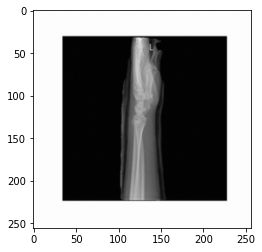

Predicted Image: 


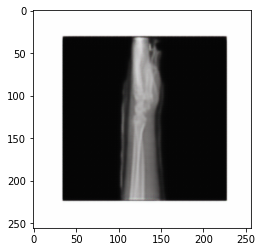

Dice Coefficient Values between predicted and actual Maks is:  tf.Tensor(0.9465551288984034, shape=(), dtype=float64)
Actual Image: 


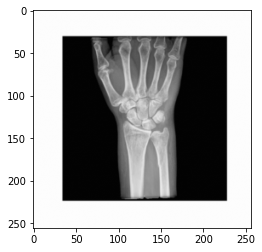

Predicted Image: 


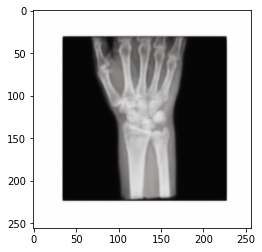

Dice Coefficient Values between predicted and actual Maks is:  tf.Tensor(0.9465551288984034, shape=(), dtype=float64)
Actual Image: 


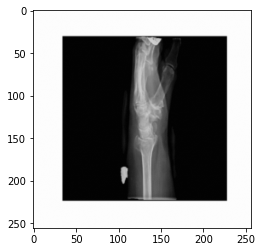

Predicted Image: 


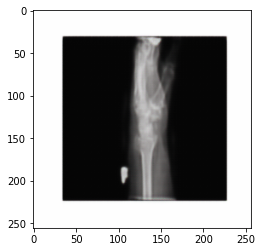

Dice Coefficient Values between predicted and actual Maks is:  tf.Tensor(0.9465551288984034, shape=(), dtype=float64)
Actual Image: 


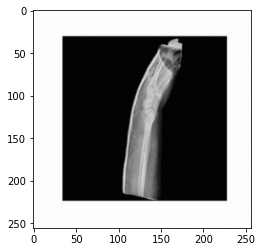

Predicted Image: 


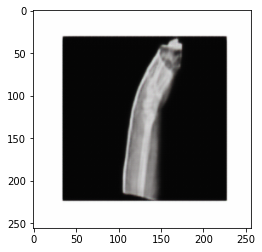

Dice Coefficient Values between predicted and actual Maks is:  tf.Tensor(0.9465551288984034, shape=(), dtype=float64)
Actual Image: 


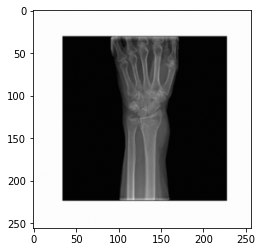

Predicted Image: 


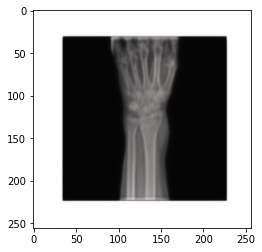

Dice Coefficient Values between predicted and actual Maks is:  tf.Tensor(0.9465551288984034, shape=(), dtype=float64)
Actual Image: 


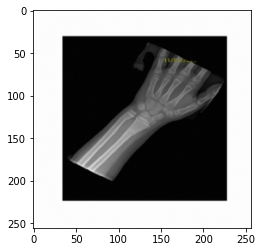

Predicted Image: 


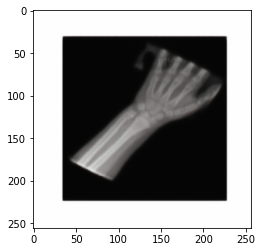

Dice Coefficient Values between predicted and actual Maks is:  tf.Tensor(0.9465551288984034, shape=(), dtype=float64)
Actual Image: 


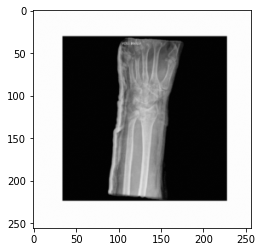

Predicted Image: 


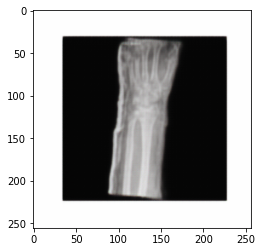

Dice Coefficient Values between predicted and actual Maks is:  tf.Tensor(0.9465551288984034, shape=(), dtype=float64)
Actual Image: 


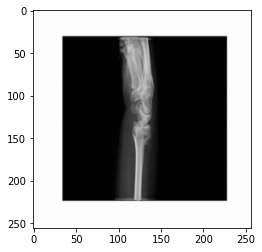

Predicted Image: 


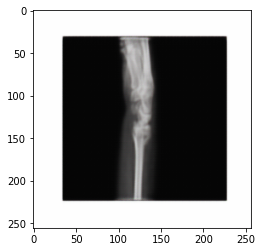

Dice Coefficient Values between predicted and actual Maks is:  tf.Tensor(0.9465551288984034, shape=(), dtype=float64)
Actual Image: 


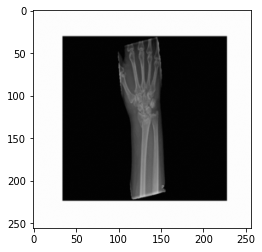

Predicted Image: 


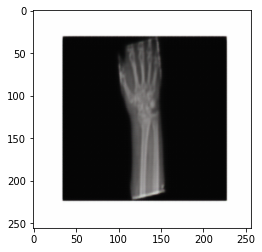

Dice Coefficient Values between predicted and actual Maks is:  tf.Tensor(0.9465551288984034, shape=(), dtype=float64)
Actual Image: 


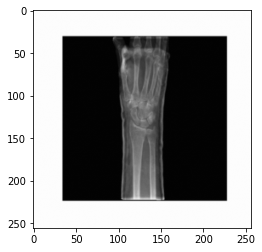

Predicted Image: 


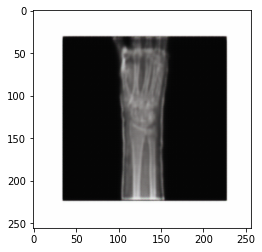

Dice Coefficient Values between predicted and actual Maks is:  tf.Tensor(0.9465551288984034, shape=(), dtype=float64)
Actual Image: 


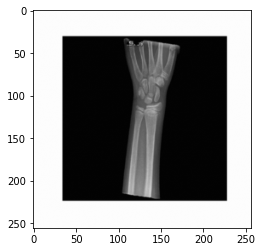

Predicted Image: 


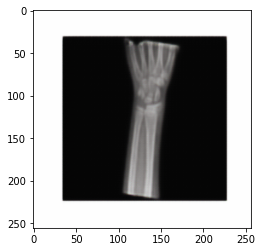

Dice Coefficient Values between predicted and actual Maks is:  tf.Tensor(0.9465551288984034, shape=(), dtype=float64)
Actual Image: 


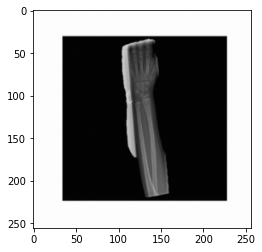

Predicted Image: 


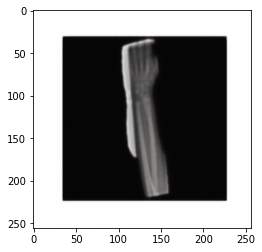

Dice Coefficient Values between predicted and actual Maks is:  tf.Tensor(0.9465551288984034, shape=(), dtype=float64)
Actual Image: 


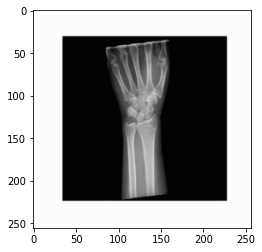

Predicted Image: 


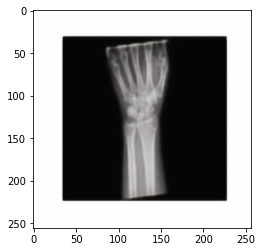

Dice Coefficient Values between predicted and actual Maks is:  tf.Tensor(0.9465551288984034, shape=(), dtype=float64)
Actual Image: 


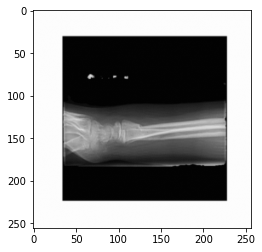

Predicted Image: 


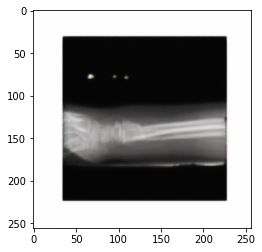

Dice Coefficient Values between predicted and actual Maks is:  tf.Tensor(0.9465551288984034, shape=(), dtype=float64)
Actual Image: 


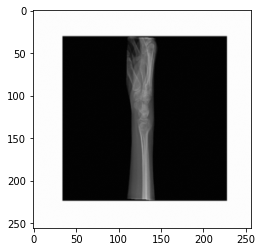

Predicted Image: 


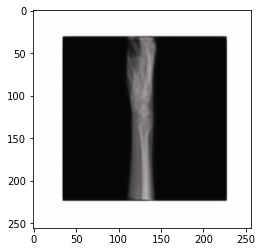

Dice Coefficient Values between predicted and actual Maks is:  tf.Tensor(0.9465551288984034, shape=(), dtype=float64)
Actual Image: 


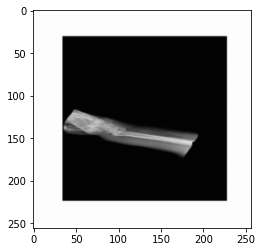

Predicted Image: 


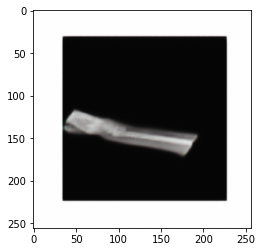

Dice Coefficient Values between predicted and actual Maks is:  tf.Tensor(0.9465551288984034, shape=(), dtype=float64)
Actual Image: 


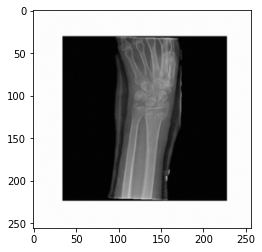

Predicted Image: 


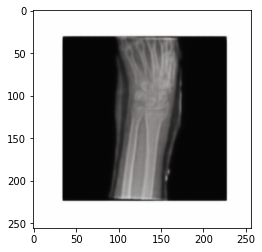

Dice Coefficient Values between predicted and actual Maks is:  tf.Tensor(0.9465551288984034, shape=(), dtype=float64)
Actual Image: 


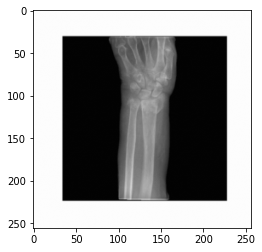

Predicted Image: 


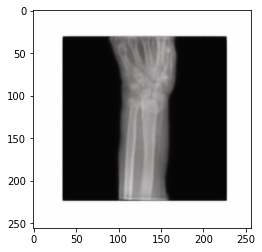

Dice Coefficient Values between predicted and actual Maks is:  tf.Tensor(0.9465551288984034, shape=(), dtype=float64)
Actual Image: 


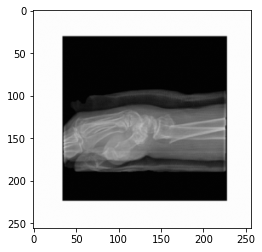

Predicted Image: 


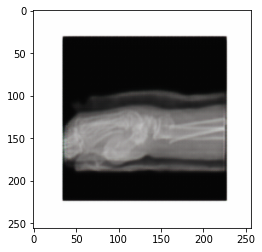

Dice Coefficient Values between predicted and actual Maks is:  tf.Tensor(0.9465551288984034, shape=(), dtype=float64)
Actual Image: 


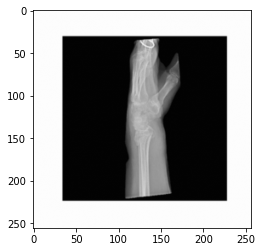

Predicted Image: 


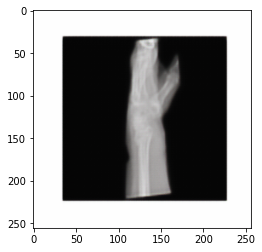

Dice Coefficient Values between predicted and actual Maks is:  tf.Tensor(0.9465551288984034, shape=(), dtype=float64)
Actual Image: 


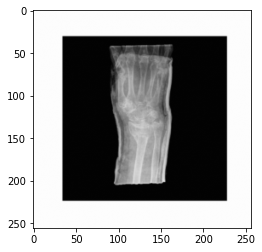

Predicted Image: 


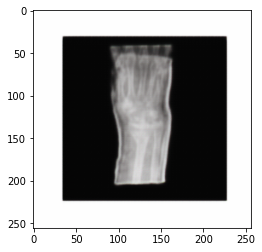

Dice Coefficient Values between predicted and actual Maks is:  tf.Tensor(0.9465551288984034, shape=(), dtype=float64)
Actual Image: 


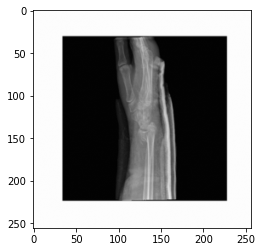

Predicted Image: 


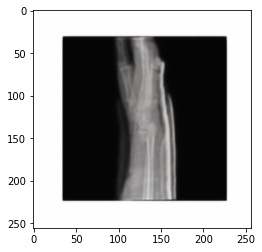

Dice Coefficient Values between predicted and actual Maks is:  tf.Tensor(0.9465551288984034, shape=(), dtype=float64)
Actual Image: 


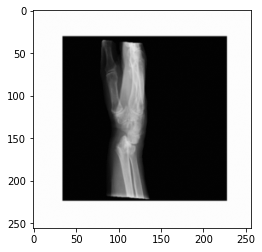

Predicted Image: 


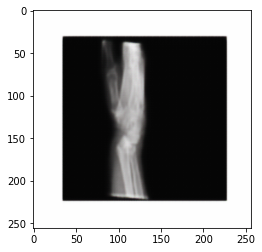

Dice Coefficient Values between predicted and actual Maks is:  tf.Tensor(0.9465551288984034, shape=(), dtype=float64)
Actual Image: 


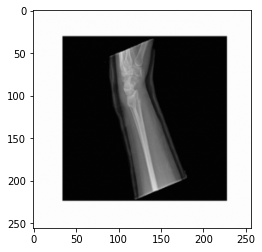

Predicted Image: 


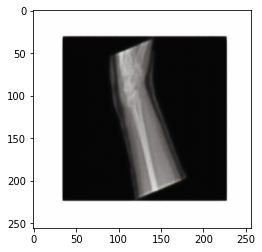

Dice Coefficient Values between predicted and actual Maks is:  tf.Tensor(0.9465551288984034, shape=(), dtype=float64)
Actual Image: 


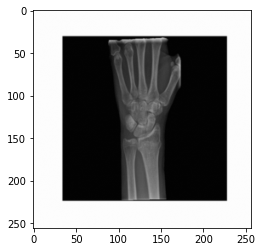

Predicted Image: 


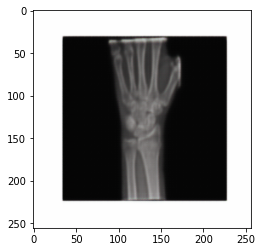

Dice Coefficient Values between predicted and actual Maks is:  tf.Tensor(0.9465551288984034, shape=(), dtype=float64)
Actual Image: 


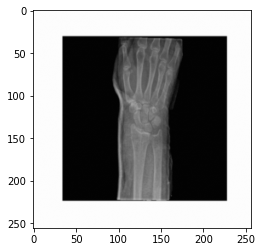

Predicted Image: 


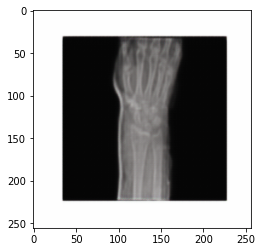

Dice Coefficient Values between predicted and actual Maks is:  tf.Tensor(0.9465551288984034, shape=(), dtype=float64)
Actual Image: 


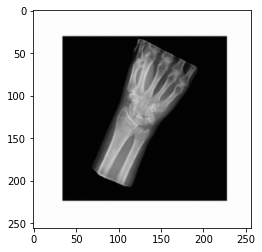

Predicted Image: 


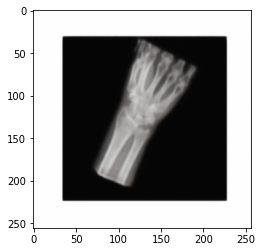

Dice Coefficient Values between predicted and actual Maks is:  tf.Tensor(0.9465551288984034, shape=(), dtype=float64)
Actual Image: 


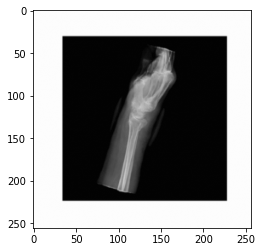

Predicted Image: 


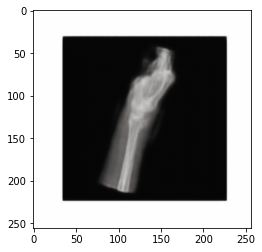

Dice Coefficient Values between predicted and actual Maks is:  tf.Tensor(0.9465551288984034, shape=(), dtype=float64)
Actual Image: 


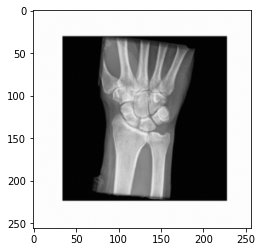

Predicted Image: 


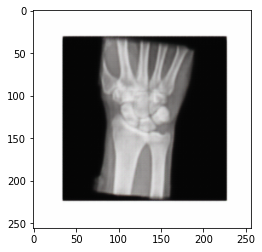

Dice Coefficient Values between predicted and actual Maks is:  tf.Tensor(0.9465551288984034, shape=(), dtype=float64)
Actual Image: 


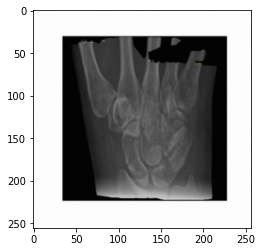

Predicted Image: 


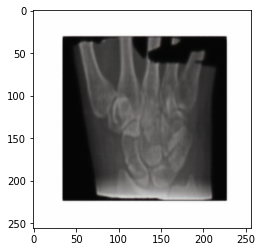

Dice Coefficient Values between predicted and actual Maks is:  tf.Tensor(0.9465551288984034, shape=(), dtype=float64)
Actual Image: 


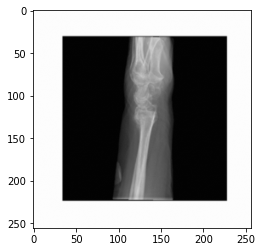

Predicted Image: 


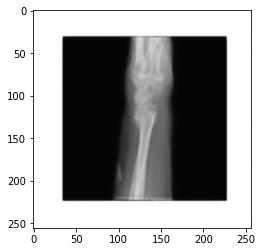

Dice Coefficient Values between predicted and actual Maks is:  tf.Tensor(0.9465551288984034, shape=(), dtype=float64)
Actual Image: 


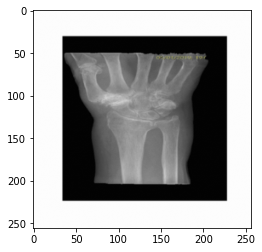

Predicted Image: 


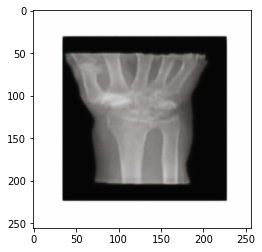

Dice Coefficient Values between predicted and actual Maks is:  tf.Tensor(0.9465551288984034, shape=(), dtype=float64)
Actual Image: 


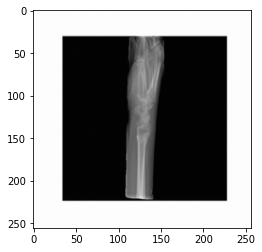

Predicted Image: 


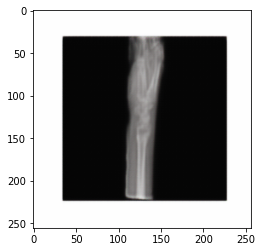

Dice Coefficient Values between predicted and actual Maks is:  tf.Tensor(0.9465551288984034, shape=(), dtype=float64)
Actual Image: 


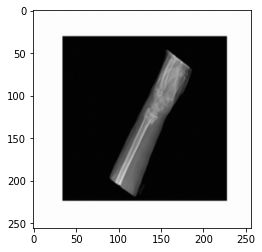

Predicted Image: 


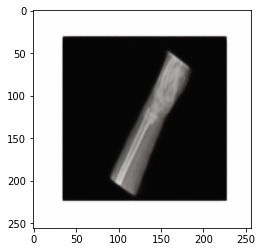

Dice Coefficient Values between predicted and actual Maks is:  tf.Tensor(0.9465551288984034, shape=(), dtype=float64)
Actual Image: 


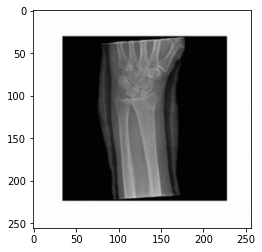

Predicted Image: 


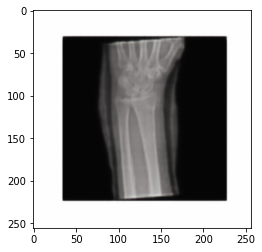

Dice Coefficient Values between predicted and actual Maks is:  tf.Tensor(0.9465551288984034, shape=(), dtype=float64)
Actual Image: 


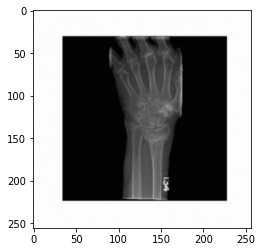

Predicted Image: 


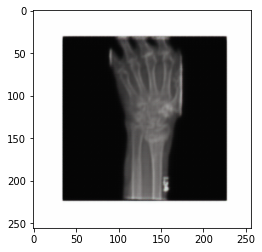

Dice Coefficient Values between predicted and actual Maks is:  tf.Tensor(0.9465551288984034, shape=(), dtype=float64)
Actual Image: 


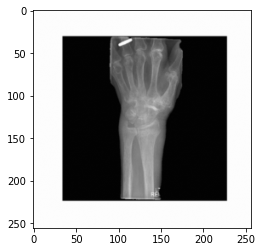

Predicted Image: 


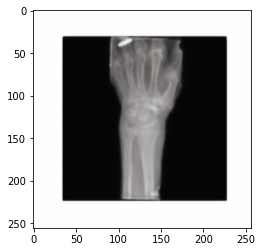

Dice Coefficient Values between predicted and actual Maks is:  tf.Tensor(0.9465551288984034, shape=(), dtype=float64)
Actual Image: 


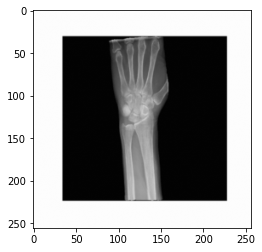

Predicted Image: 


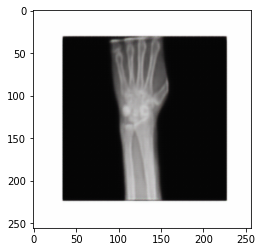

Dice Coefficient Values between predicted and actual Maks is:  tf.Tensor(0.9465551288984034, shape=(), dtype=float64)
Actual Image: 


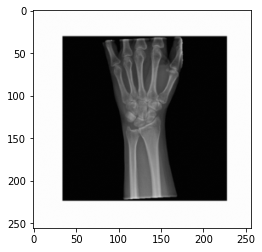

Predicted Image: 


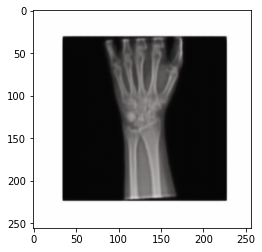

Dice Coefficient Values between predicted and actual Maks is:  tf.Tensor(0.9465551288984034, shape=(), dtype=float64)
Actual Image: 


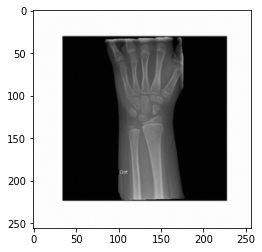

Predicted Image: 


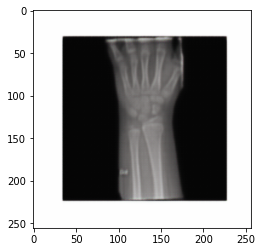

Dice Coefficient Values between predicted and actual Maks is:  tf.Tensor(0.9465551288984034, shape=(), dtype=float64)
Actual Image: 


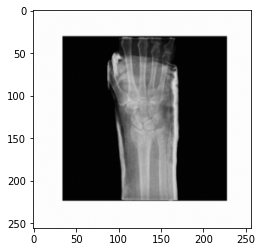

Predicted Image: 


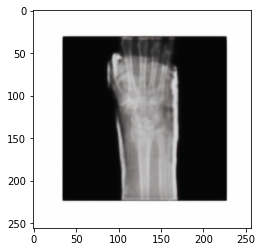

Dice Coefficient Values between predicted and actual Maks is:  tf.Tensor(0.9465551288984034, shape=(), dtype=float64)
Actual Image: 


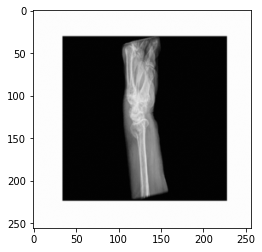

Predicted Image: 


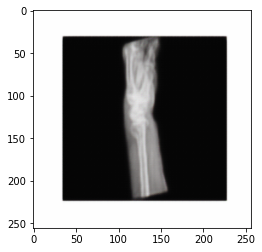

Dice Coefficient Values between predicted and actual Maks is:  tf.Tensor(0.9465551288984034, shape=(), dtype=float64)
Actual Image: 


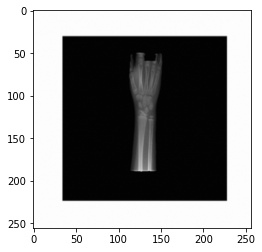

Predicted Image: 


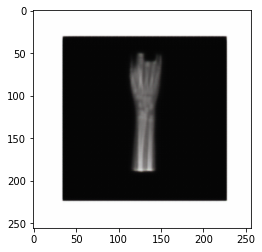

Dice Coefficient Values between predicted and actual Maks is:  tf.Tensor(0.9465551288984034, shape=(), dtype=float64)
Actual Image: 


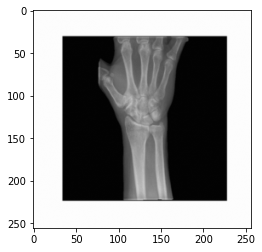

Predicted Image: 


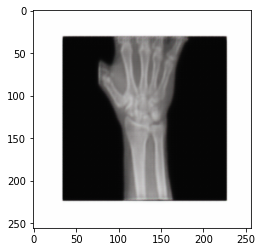

Dice Coefficient Values between predicted and actual Maks is:  tf.Tensor(0.9465551288984034, shape=(), dtype=float64)
Actual Image: 


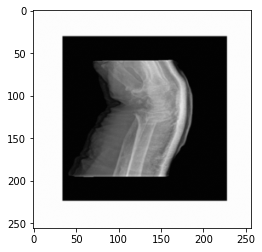

Predicted Image: 


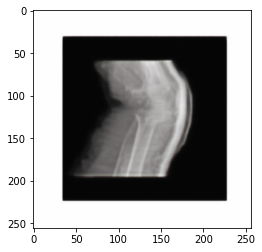

Dice Coefficient Values between predicted and actual Maks is:  tf.Tensor(0.9465551288984034, shape=(), dtype=float64)
Actual Image: 


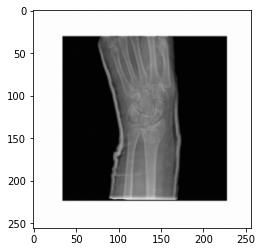

Predicted Image: 


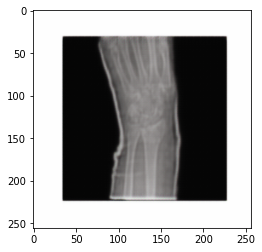

Dice Coefficient Values between predicted and actual Maks is:  tf.Tensor(0.9465551288984034, shape=(), dtype=float64)
Actual Image: 


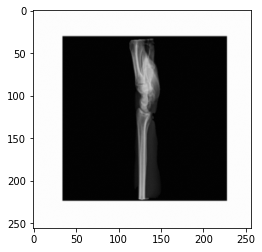

Predicted Image: 


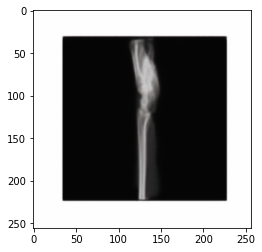

Dice Coefficient Values between predicted and actual Maks is:  tf.Tensor(0.9465551288984034, shape=(), dtype=float64)
Actual Image: 


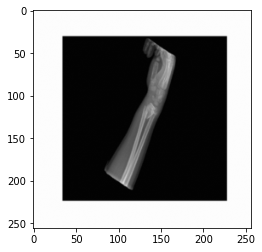

Predicted Image: 


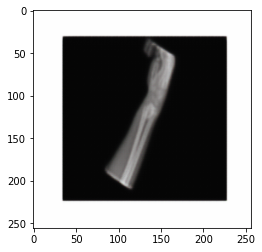

Dice Coefficient Values between predicted and actual Maks is:  tf.Tensor(0.9465551288984034, shape=(), dtype=float64)
Actual Image: 


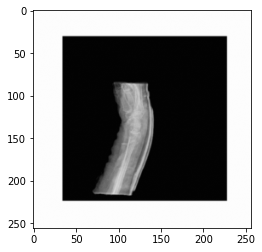

Predicted Image: 


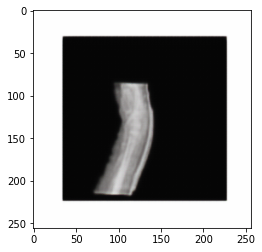

Dice Coefficient Values between predicted and actual Maks is:  tf.Tensor(0.9465551288984034, shape=(), dtype=float64)
Actual Image: 


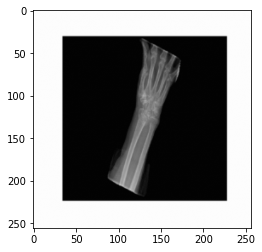

Predicted Image: 


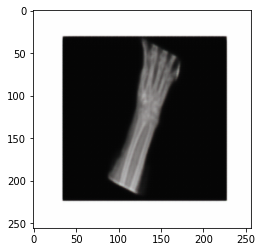

Dice Coefficient Values between predicted and actual Maks is:  tf.Tensor(0.9465551288984034, shape=(), dtype=float64)
Actual Image: 


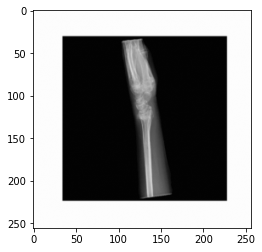

Predicted Image: 


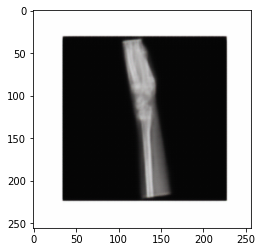

Dice Coefficient Values between predicted and actual Maks is:  tf.Tensor(0.9465551288984034, shape=(), dtype=float64)
Actual Image: 


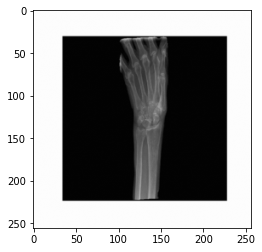

Predicted Image: 


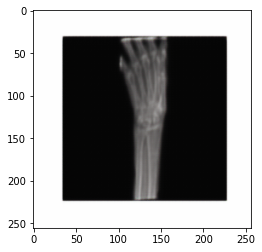

Dice Coefficient Values between predicted and actual Maks is:  tf.Tensor(0.9465551288984034, shape=(), dtype=float64)
Actual Image: 


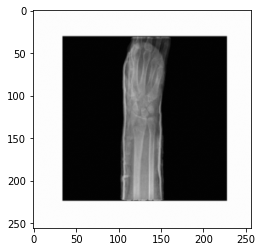

Predicted Image: 


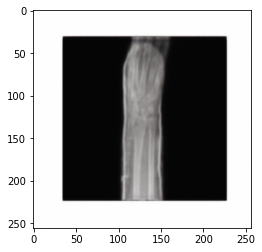

Dice Coefficient Values between predicted and actual Maks is:  tf.Tensor(0.9465551288984034, shape=(), dtype=float64)
Actual Image: 


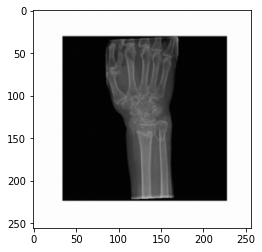

Predicted Image: 


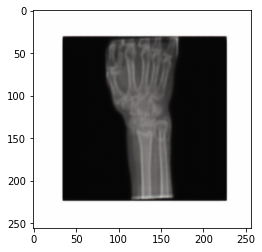

Dice Coefficient Values between predicted and actual Maks is:  tf.Tensor(0.9465551288984034, shape=(), dtype=float64)
Actual Image: 


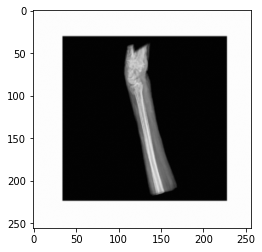

Predicted Image: 


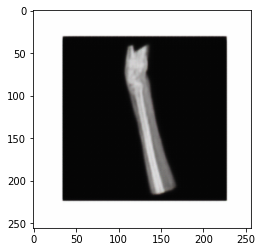

Dice Coefficient Values between predicted and actual Maks is:  tf.Tensor(0.9465551288984034, shape=(), dtype=float64)
Actual Image: 


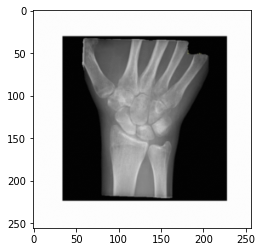

Predicted Image: 


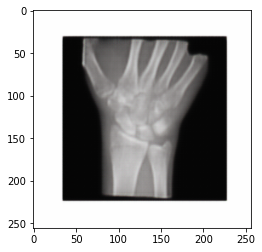

Dice Coefficient Values between predicted and actual Maks is:  tf.Tensor(0.9465551288984034, shape=(), dtype=float64)
Actual Image: 


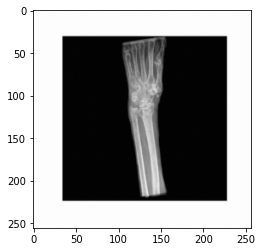

Predicted Image: 


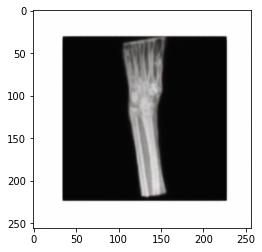

Dice Coefficient Values between predicted and actual Maks is:  tf.Tensor(0.9465551288984034, shape=(), dtype=float64)
Actual Image: 


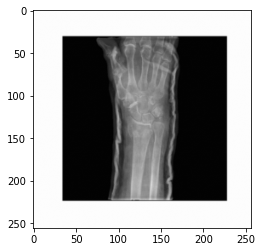

Predicted Image: 


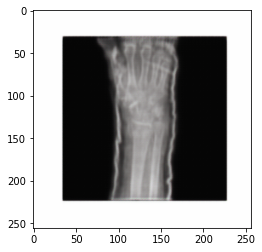

Dice Coefficient Values between predicted and actual Maks is:  tf.Tensor(0.9465551288984034, shape=(), dtype=float64)
Actual Image: 


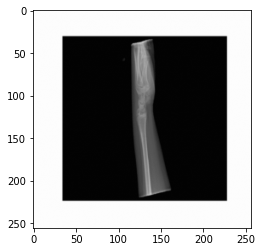

Predicted Image: 


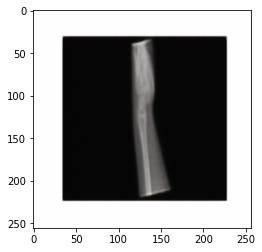

Dice Coefficient Values between predicted and actual Maks is:  tf.Tensor(0.9465551288984034, shape=(), dtype=float64)
Actual Image: 


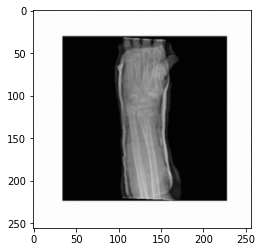

Predicted Image: 


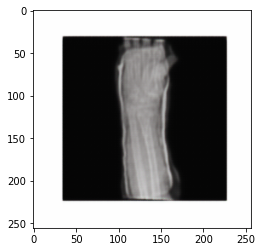

Dice Coefficient Values between predicted and actual Maks is:  tf.Tensor(0.9465551288984034, shape=(), dtype=float64)
Actual Image: 


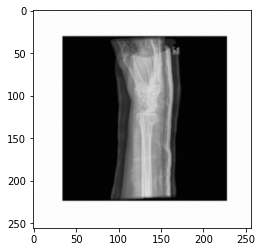

Predicted Image: 


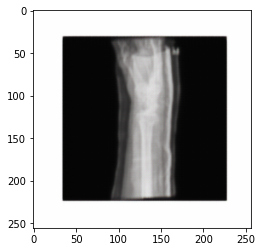

Dice Coefficient Values between predicted and actual Maks is:  tf.Tensor(0.9465551288984034, shape=(), dtype=float64)
Actual Image: 


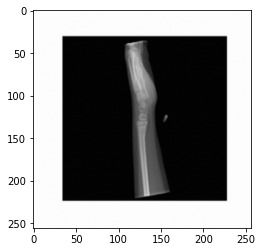

Predicted Image: 


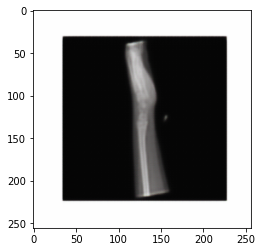

Dice Coefficient Values between predicted and actual Maks is:  tf.Tensor(0.9465551288984034, shape=(), dtype=float64)
Actual Image: 


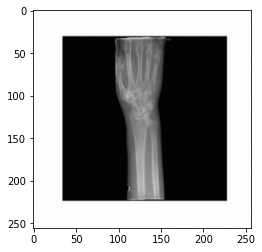

Predicted Image: 


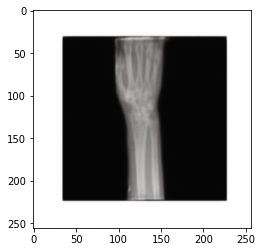

Dice Coefficient Values between predicted and actual Maks is:  tf.Tensor(0.9465551288984034, shape=(), dtype=float64)
Actual Image: 


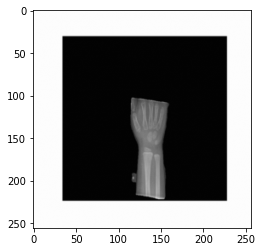

Predicted Image: 


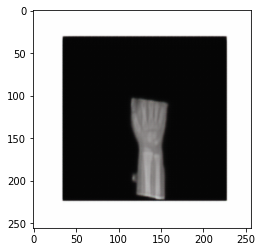

Dice Coefficient Values between predicted and actual Maks is:  tf.Tensor(0.9465551288984034, shape=(), dtype=float64)
Actual Image: 


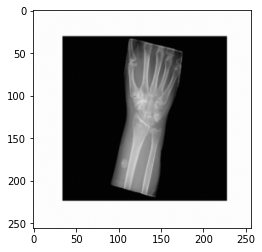

Predicted Image: 


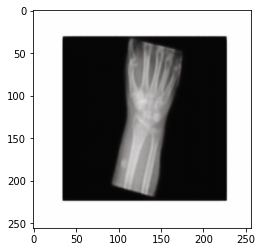

Dice Coefficient Values between predicted and actual Maks is:  tf.Tensor(0.9465551288984034, shape=(), dtype=float64)
Actual Image: 


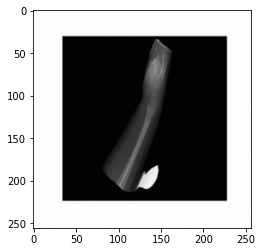

Predicted Image: 


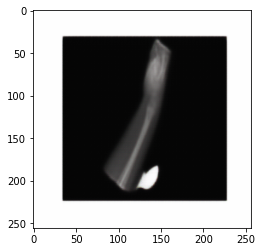

Dice Coefficient Values between predicted and actual Maks is:  tf.Tensor(0.9465551288984034, shape=(), dtype=float64)
Actual Image: 


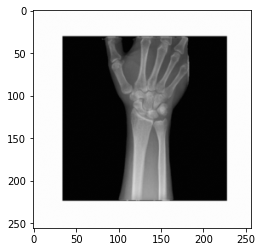

Predicted Image: 


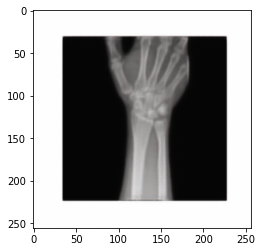

Dice Coefficient Values between predicted and actual Maks is:  tf.Tensor(0.9465551288984034, shape=(), dtype=float64)
Actual Image: 


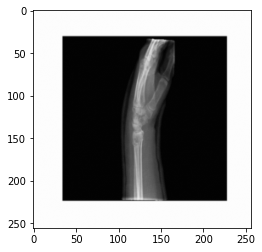

Predicted Image: 


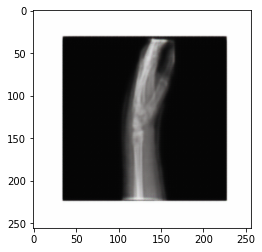

Dice Coefficient Values between predicted and actual Maks is:  tf.Tensor(0.9465551288984034, shape=(), dtype=float64)
Actual Image: 


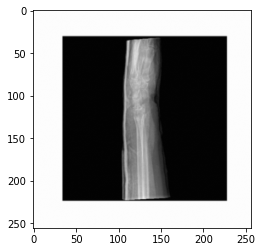

Predicted Image: 


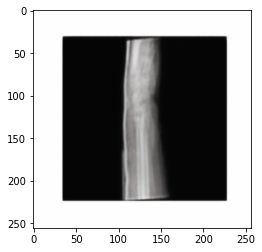

Dice Coefficient Values between predicted and actual Maks is:  tf.Tensor(0.9465551288984034, shape=(), dtype=float64)
Actual Image: 


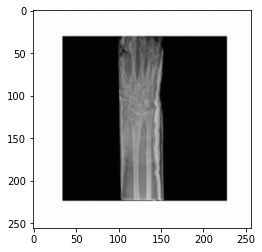

Predicted Image: 


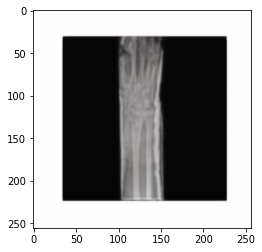

Dice Coefficient Values between predicted and actual Maks is:  tf.Tensor(0.9465551288984034, shape=(), dtype=float64)
Actual Image: 


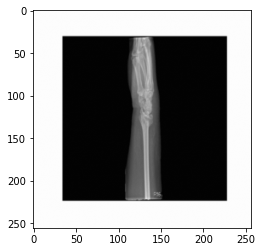

Predicted Image: 


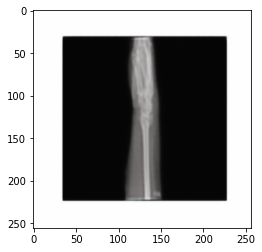

Dice Coefficient Values between predicted and actual Maks is:  tf.Tensor(0.9465551288984034, shape=(), dtype=float64)
Actual Image: 


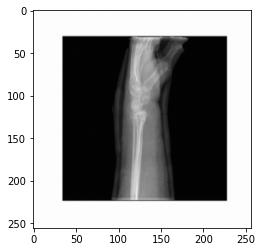

Predicted Image: 


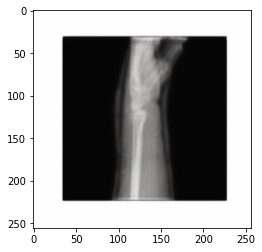

Dice Coefficient Values between predicted and actual Maks is:  tf.Tensor(0.9465551288984034, shape=(), dtype=float64)
Actual Image: 


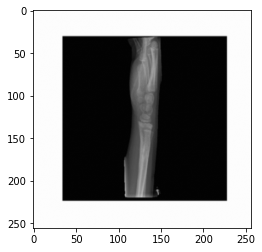

Predicted Image: 


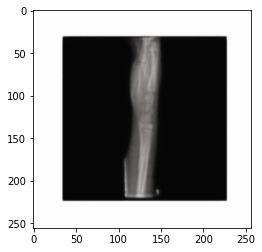

Dice Coefficient Values between predicted and actual Maks is:  tf.Tensor(0.9465551288984034, shape=(), dtype=float64)
Actual Image: 


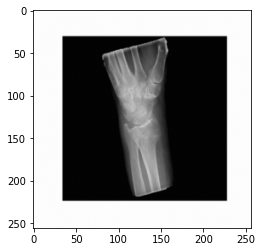

Predicted Image: 


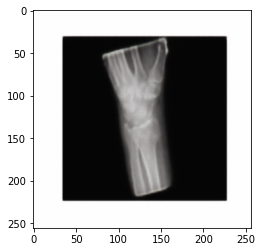

Dice Coefficient Values between predicted and actual Maks is:  tf.Tensor(0.9465551288984034, shape=(), dtype=float64)
Actual Image: 


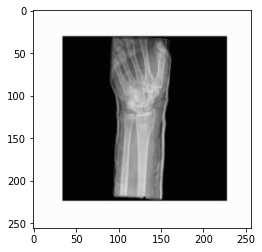

Predicted Image: 


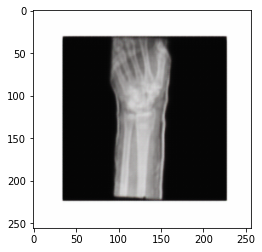

Dice Coefficient Values between predicted and actual Maks is:  tf.Tensor(0.9465551288984034, shape=(), dtype=float64)
Actual Image: 


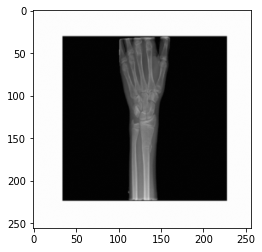

Predicted Image: 


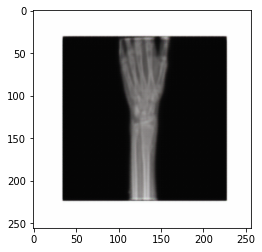

Dice Coefficient Values between predicted and actual Maks is:  tf.Tensor(0.9465551288984034, shape=(), dtype=float64)
Actual Image: 


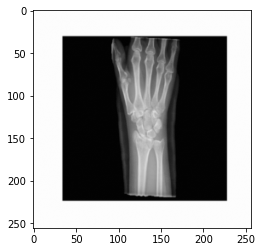

Predicted Image: 


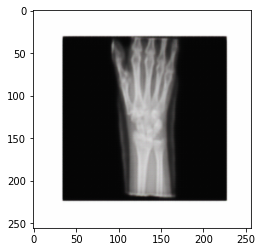

Dice Coefficient Values between predicted and actual Maks is:  tf.Tensor(0.9465551288984034, shape=(), dtype=float64)
Actual Image: 


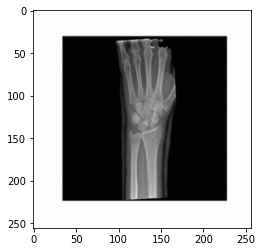

Predicted Image: 


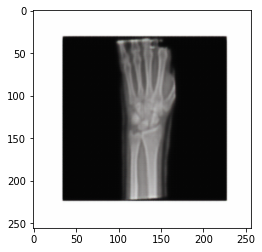

Dice Coefficient Values between predicted and actual Maks is:  tf.Tensor(0.9465551288984034, shape=(), dtype=float64)
Actual Image: 


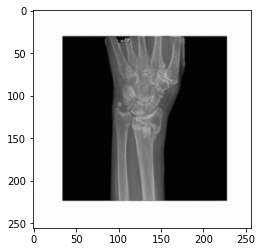

Predicted Image: 


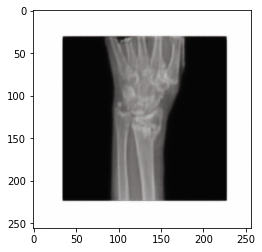

Dice Coefficient Values between predicted and actual Maks is:  tf.Tensor(0.9465551288984034, shape=(), dtype=float64)
Actual Image: 


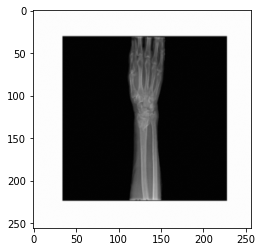

Predicted Image: 


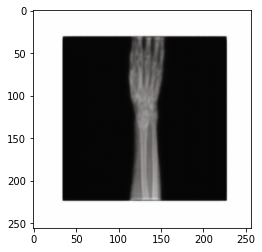

Dice Coefficient Values between predicted and actual Maks is:  tf.Tensor(0.9465551288984034, shape=(), dtype=float64)
Actual Image: 


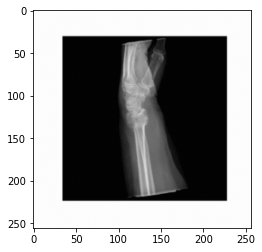

Predicted Image: 


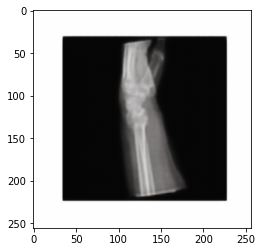

Dice Coefficient Values between predicted and actual Maks is:  tf.Tensor(0.9465551288984034, shape=(), dtype=float64)
Actual Image: 


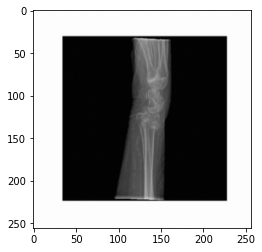

Predicted Image: 


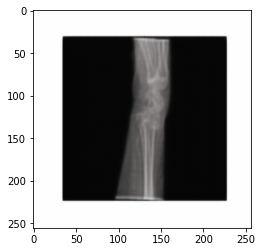

Dice Coefficient Values between predicted and actual Maks is:  tf.Tensor(0.9465551288984034, shape=(), dtype=float64)
Actual Image: 


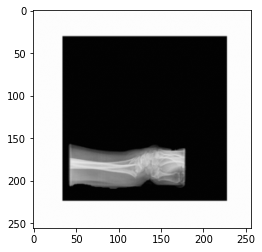

Predicted Image: 


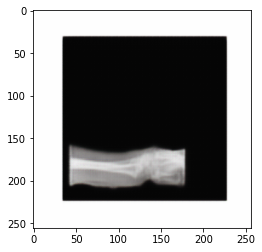

Dice Coefficient Values between predicted and actual Maks is:  tf.Tensor(0.9465551288984034, shape=(), dtype=float64)
Actual Image: 


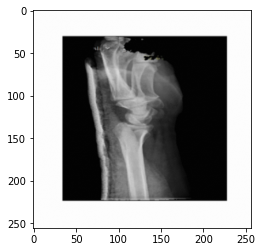

Predicted Image: 


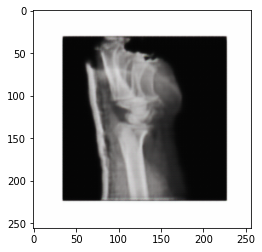

Dice Coefficient Values between predicted and actual Maks is:  tf.Tensor(0.9465551288984034, shape=(), dtype=float64)
Actual Image: 


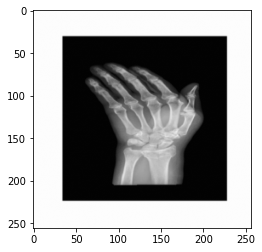

Predicted Image: 


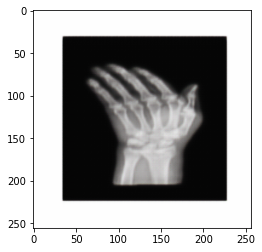

Dice Coefficient Values between predicted and actual Maks is:  tf.Tensor(0.9465551288984034, shape=(), dtype=float64)
Actual Image: 


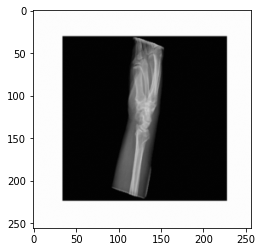

Predicted Image: 


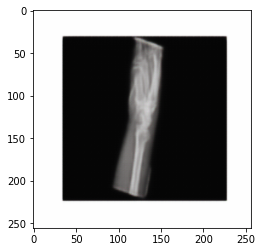

Dice Coefficient Values between predicted and actual Maks is:  tf.Tensor(0.9465551288984034, shape=(), dtype=float64)
Actual Image: 


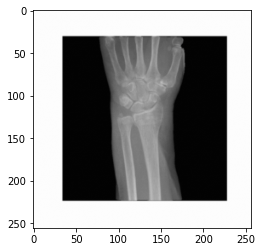

Predicted Image: 


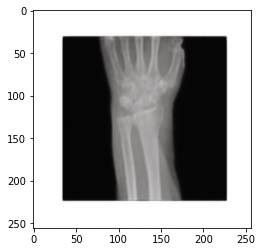

Dice Coefficient Values between predicted and actual Maks is:  tf.Tensor(0.9465551288984034, shape=(), dtype=float64)
Actual Image: 


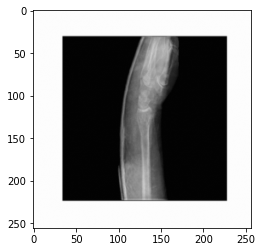

Predicted Image: 


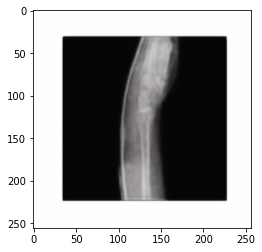

Dice Coefficient Values between predicted and actual Maks is:  tf.Tensor(0.9465551288984034, shape=(), dtype=float64)
Actual Image: 


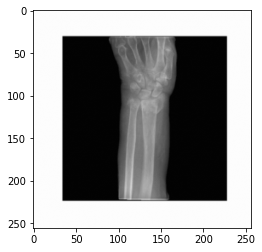

Predicted Image: 


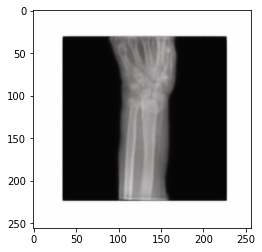

Dice Coefficient Values between predicted and actual Maks is:  tf.Tensor(0.9465551288984034, shape=(), dtype=float64)
Actual Image: 


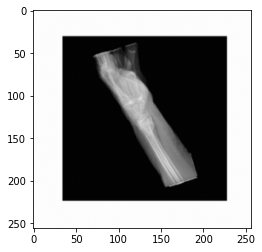

Predicted Image: 


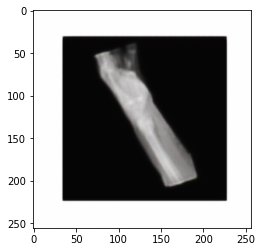

Dice Coefficient Values between predicted and actual Maks is:  tf.Tensor(0.9465551288984034, shape=(), dtype=float64)
Actual Image: 


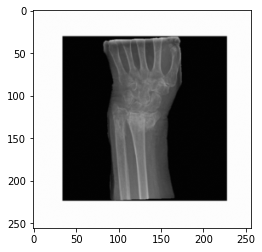

Predicted Image: 


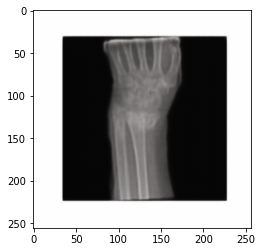

Dice Coefficient Values between predicted and actual Maks is:  tf.Tensor(0.9465551288984034, shape=(), dtype=float64)
Actual Image: 


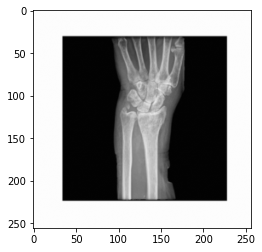

Predicted Image: 


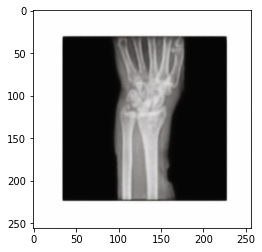

Dice Coefficient Values between predicted and actual Maks is:  tf.Tensor(0.9465551288984034, shape=(), dtype=float64)
Actual Image: 


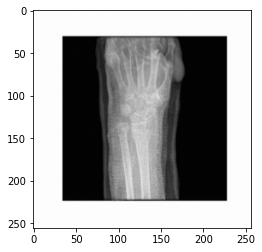

Predicted Image: 


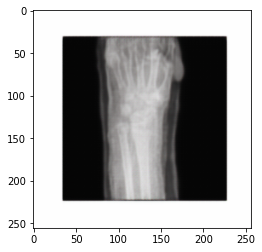

Dice Coefficient Values between predicted and actual Maks is:  tf.Tensor(0.9465551288984034, shape=(), dtype=float64)
Actual Image: 


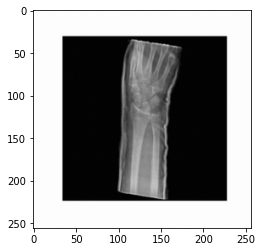

Predicted Image: 


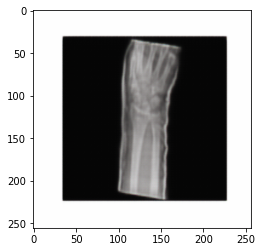

Dice Coefficient Values between predicted and actual Maks is:  tf.Tensor(0.9465551288984034, shape=(), dtype=float64)
Actual Image: 


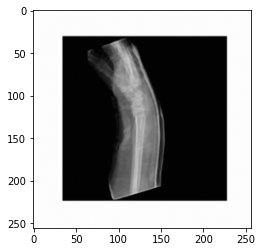

Predicted Image: 


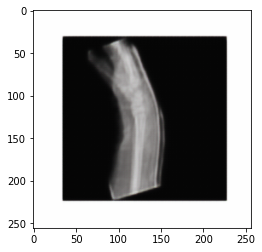

Dice Coefficient Values between predicted and actual Maks is:  tf.Tensor(0.9465551288984034, shape=(), dtype=float64)


In [12]:
##################### Showing Positive Bone Actual and Predicted Images #####################

for i in range(X_test.shape[0]):

  print("Actual Image: ")
  plt.imshow (y_test[i])
  plt.show()
  print("Predicted Image: ")
  plt.imshow (output[i])
  plt.show()


  tmp_dice_coeff = dice_coeff (y_test, output)
  print("Dice Coefficient Values between predicted and actual Maks is: ", tmp_dice_coeff )
  
  #intersaction = np.logical_and(y_test, output)
  #union = np.logical_or(y_test, output)
  #iou_score = np.sum(intersaction) / np.sum(union)
  #print("IOU score is: ", iou_score)




In [13]:
################# Showing accuracy on Negative Bone Images ##############

os.chdir( "{}/Bone_Fracture/Negative/".format(directory_path) )
print("Showing Test Folder Images Names: ")
# !ls

################### Loading Stored Auto-Encoder Model #########################
# model_path = "{}/autoencoder.h5".format(directory_path)
# autoencoder = keras.models.load_model(model_path)

testfolder_directory = "{}/Bone_Fracture/Negative/".format(directory_path)
all_negative_bone_images_paths = glob.glob('{}/*.png'.format(testfolder_directory) )

negative_test_img_bone_array = np.zeros((len(all_negative_bone_images_paths[:100]),256,256,4))

for i, tmp_path in enumerate(all_negative_bone_images_paths[:100]):

  print("Adding {} Bone Image to Numpy Array".format ( os.path.basename(tmp_path)) )
  
  img = io.imread(tmp_path)
  img_resized = resize(img, (256,256,4))

  negative_test_img_bone_array[i] = img_resized

output_negative = autoencoder.predict(negative_test_img_bone_array)


############# Fiding the loss Between Actual Negative Bone images and Predicted Bone Images ##############
mse_loses_negative= tf.keras.metrics.mean_squared_error(negative_test_img_bone_array, output_negative)
print(mse_loses_negative.shape)
mse_loses_negative= tf.reduce_sum(mse_loses_negative, axis=-1)
mse_loses_negative= tf.reduce_sum(mse_loses_negative, axis=-1)
print("Individual Losses Between Actual Negative Bone images and Predicted Bone Images: ", mse_loses_negative)

mse_loss_threshod = 200

predicted_class_negative = mse_loses_negative <= mse_loss_threshod

actual_test_labels_negative = np.zeros(negative_test_img_bone_array.shape[0])

from sklearn.metrics import accuracy_score

model_accuracy = accuracy_score(actual_test_labels_negative, predicted_class_negative)
print("Auto-Encoder Model Accuracy on Test Negative Bone Images is : ", model_accuracy, " OR ", model_accuracy*100, "%" )



Showing Test Folder Images Names: 
Adding image (2359).png Bone Image to Numpy Array
Adding image (3907).png Bone Image to Numpy Array
Adding image (2305).png Bone Image to Numpy Array
Adding image (2671).png Bone Image to Numpy Array
Adding image (3756).png Bone Image to Numpy Array
Adding image (3629).png Bone Image to Numpy Array
Adding image (2599).png Bone Image to Numpy Array
Adding image (2419).png Bone Image to Numpy Array
Adding image (2833).png Bone Image to Numpy Array
Adding image (2074).png Bone Image to Numpy Array
Adding image (2190).png Bone Image to Numpy Array
Adding image (2186).png Bone Image to Numpy Array
Adding image (2235).png Bone Image to Numpy Array
Adding image (3809).png Bone Image to Numpy Array
Adding image (3443).png Bone Image to Numpy Array
Adding image (2399).png Bone Image to Numpy Array
Adding image (3266).png Bone Image to Numpy Array
Adding image (3316).png Bone Image to Numpy Array
Adding image (3964).png Bone Image to Numpy Array
Adding image (2

Actual Image: 


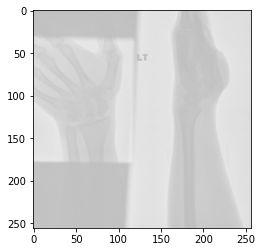

Predicted Image: 


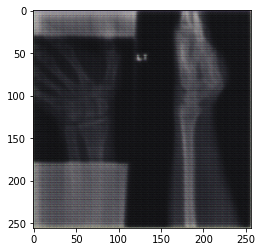

Dice Coefficient Values between predicted and actual Maks is:  tf.Tensor(0.4035864821491937, shape=(), dtype=float64)
Actual Image: 


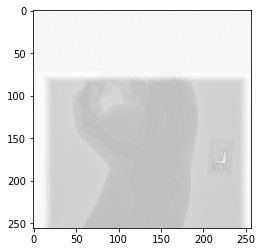

Predicted Image: 


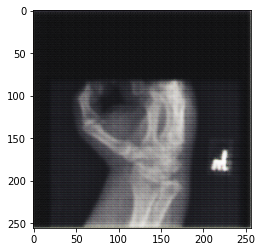

Dice Coefficient Values between predicted and actual Maks is:  tf.Tensor(0.4035864821491937, shape=(), dtype=float64)
Actual Image: 


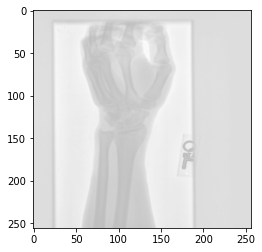

Predicted Image: 


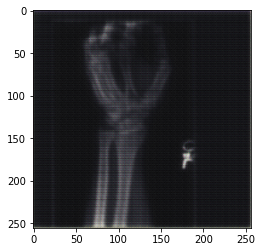

Dice Coefficient Values between predicted and actual Maks is:  tf.Tensor(0.4035864821491937, shape=(), dtype=float64)
Actual Image: 


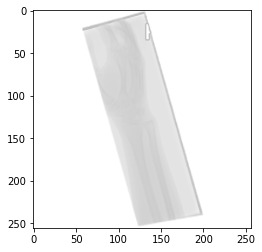

Predicted Image: 


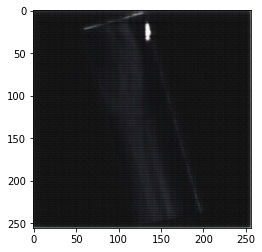

Dice Coefficient Values between predicted and actual Maks is:  tf.Tensor(0.4035864821491937, shape=(), dtype=float64)
Actual Image: 


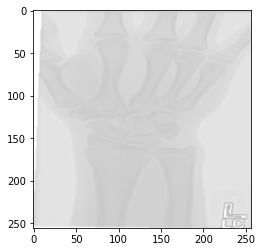

Predicted Image: 


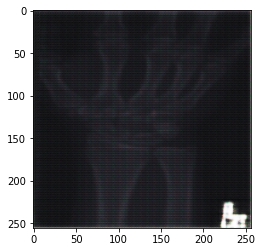

Dice Coefficient Values between predicted and actual Maks is:  tf.Tensor(0.4035864821491937, shape=(), dtype=float64)
Actual Image: 


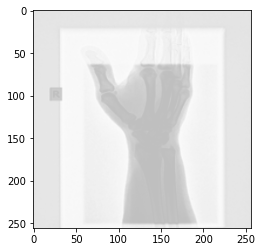

Predicted Image: 


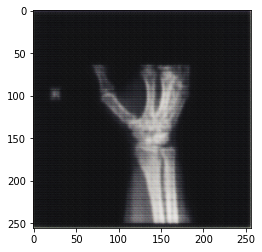

Dice Coefficient Values between predicted and actual Maks is:  tf.Tensor(0.4035864821491937, shape=(), dtype=float64)
Actual Image: 


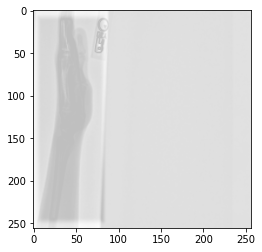

Predicted Image: 


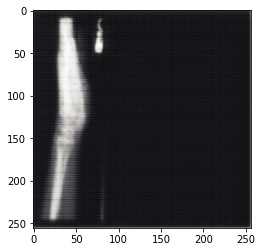

Dice Coefficient Values between predicted and actual Maks is:  tf.Tensor(0.4035864821491937, shape=(), dtype=float64)
Actual Image: 


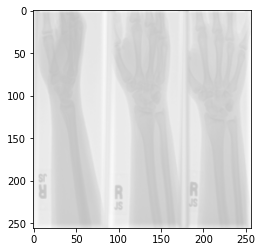

Predicted Image: 


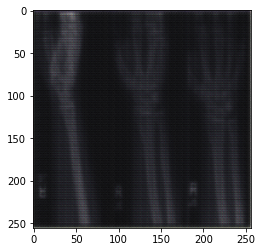

Dice Coefficient Values between predicted and actual Maks is:  tf.Tensor(0.4035864821491937, shape=(), dtype=float64)
Actual Image: 


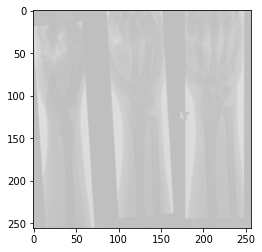

Predicted Image: 


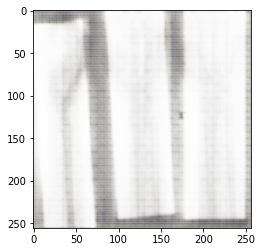

Dice Coefficient Values between predicted and actual Maks is:  tf.Tensor(0.4035864821491937, shape=(), dtype=float64)
Actual Image: 


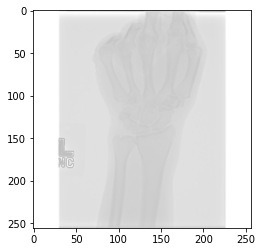

Predicted Image: 


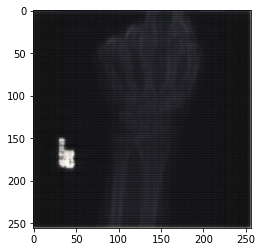

Dice Coefficient Values between predicted and actual Maks is:  tf.Tensor(0.4035864821491937, shape=(), dtype=float64)
Actual Image: 


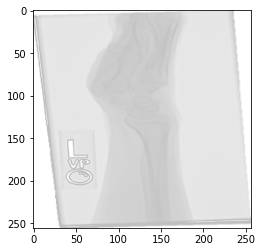

Predicted Image: 


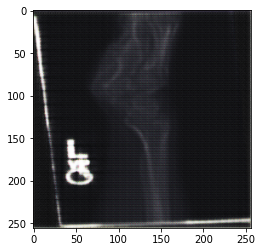

Dice Coefficient Values between predicted and actual Maks is:  tf.Tensor(0.4035864821491937, shape=(), dtype=float64)
Actual Image: 


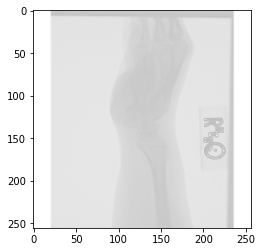

Predicted Image: 


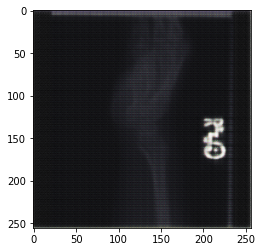

Dice Coefficient Values between predicted and actual Maks is:  tf.Tensor(0.4035864821491937, shape=(), dtype=float64)
Actual Image: 


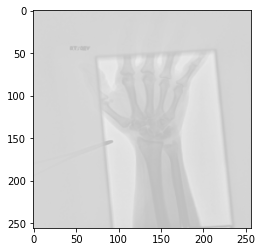

Predicted Image: 


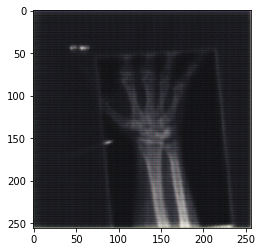

Dice Coefficient Values between predicted and actual Maks is:  tf.Tensor(0.4035864821491937, shape=(), dtype=float64)
Actual Image: 


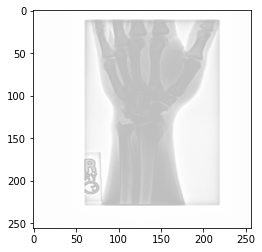

Predicted Image: 


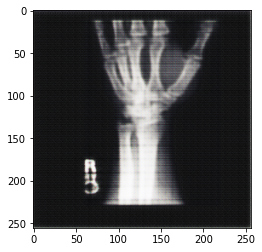

Dice Coefficient Values between predicted and actual Maks is:  tf.Tensor(0.4035864821491937, shape=(), dtype=float64)
Actual Image: 


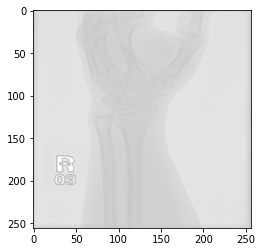

Predicted Image: 


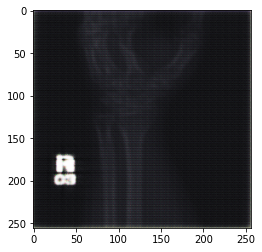

Dice Coefficient Values between predicted and actual Maks is:  tf.Tensor(0.4035864821491937, shape=(), dtype=float64)
Actual Image: 


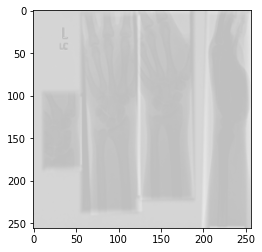

Predicted Image: 


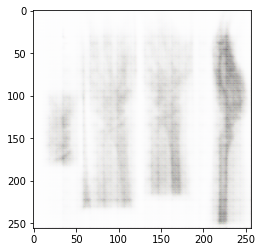

Dice Coefficient Values between predicted and actual Maks is:  tf.Tensor(0.4035864821491937, shape=(), dtype=float64)
Actual Image: 


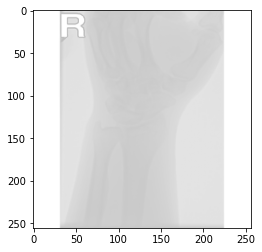

Predicted Image: 


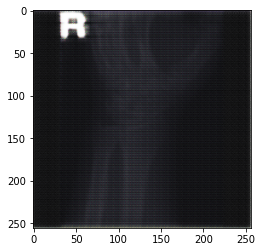

Dice Coefficient Values between predicted and actual Maks is:  tf.Tensor(0.4035864821491937, shape=(), dtype=float64)
Actual Image: 


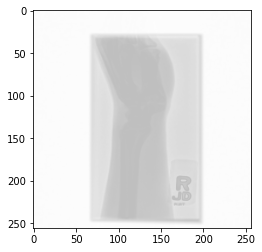

Predicted Image: 


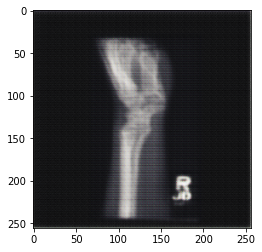

Dice Coefficient Values between predicted and actual Maks is:  tf.Tensor(0.4035864821491937, shape=(), dtype=float64)
Actual Image: 


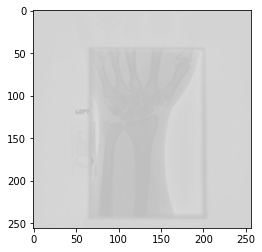

Predicted Image: 


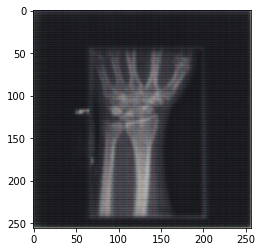

Dice Coefficient Values between predicted and actual Maks is:  tf.Tensor(0.4035864821491937, shape=(), dtype=float64)
Actual Image: 


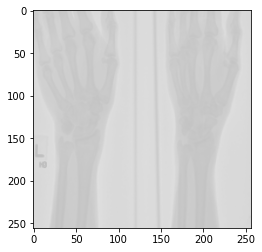

Predicted Image: 


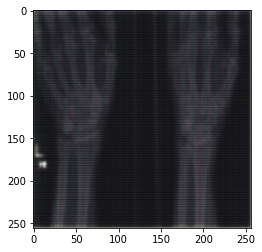

Dice Coefficient Values between predicted and actual Maks is:  tf.Tensor(0.4035864821491937, shape=(), dtype=float64)
Actual Image: 


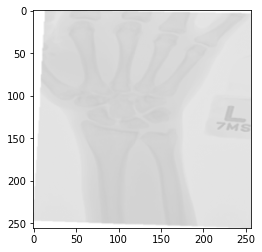

Predicted Image: 


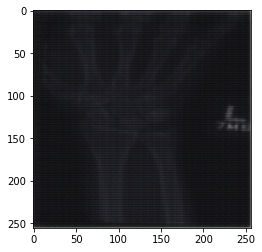

Dice Coefficient Values between predicted and actual Maks is:  tf.Tensor(0.4035864821491937, shape=(), dtype=float64)
Actual Image: 


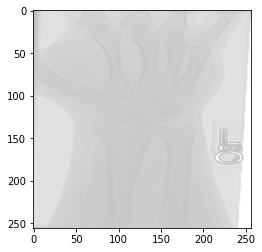

Predicted Image: 


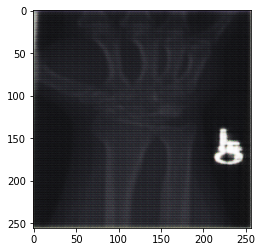

Dice Coefficient Values between predicted and actual Maks is:  tf.Tensor(0.4035864821491937, shape=(), dtype=float64)
Actual Image: 


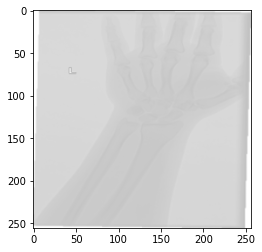

Predicted Image: 


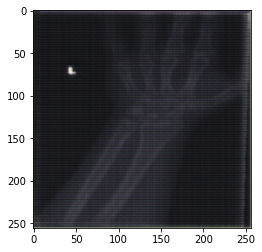

Dice Coefficient Values between predicted and actual Maks is:  tf.Tensor(0.4035864821491937, shape=(), dtype=float64)
Actual Image: 


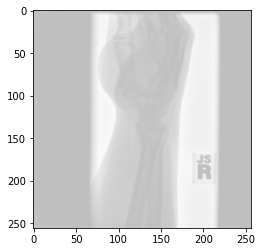

Predicted Image: 


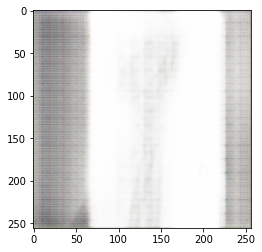

Dice Coefficient Values between predicted and actual Maks is:  tf.Tensor(0.4035864821491937, shape=(), dtype=float64)
Actual Image: 


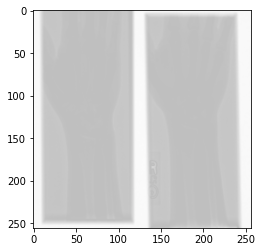

Predicted Image: 


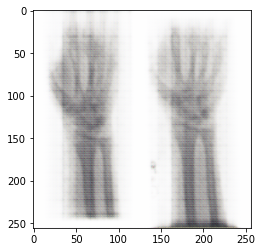

Dice Coefficient Values between predicted and actual Maks is:  tf.Tensor(0.4035864821491937, shape=(), dtype=float64)
Actual Image: 


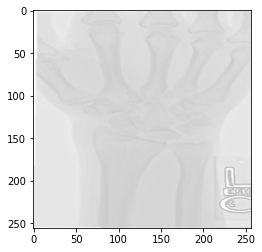

Predicted Image: 


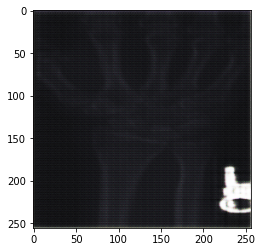

Dice Coefficient Values between predicted and actual Maks is:  tf.Tensor(0.4035864821491937, shape=(), dtype=float64)
Actual Image: 


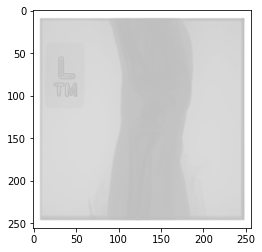

Predicted Image: 


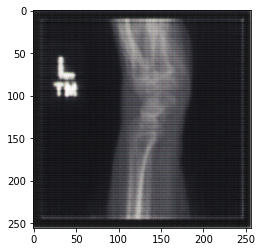

Dice Coefficient Values between predicted and actual Maks is:  tf.Tensor(0.4035864821491937, shape=(), dtype=float64)
Actual Image: 


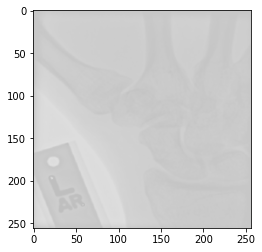

Predicted Image: 


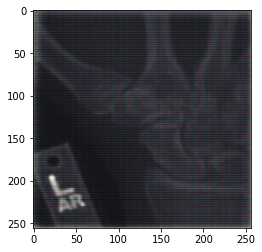

Dice Coefficient Values between predicted and actual Maks is:  tf.Tensor(0.4035864821491937, shape=(), dtype=float64)
Actual Image: 


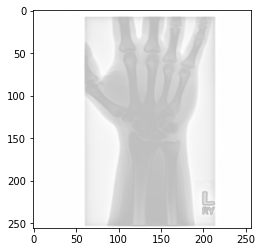

Predicted Image: 


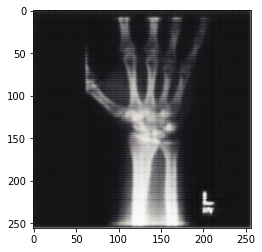

Dice Coefficient Values between predicted and actual Maks is:  tf.Tensor(0.4035864821491937, shape=(), dtype=float64)
Actual Image: 


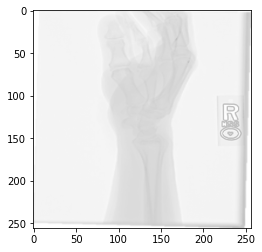

Predicted Image: 


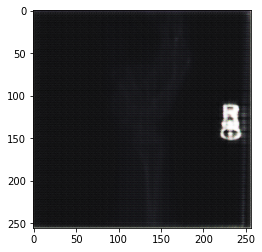

Dice Coefficient Values between predicted and actual Maks is:  tf.Tensor(0.4035864821491937, shape=(), dtype=float64)
Actual Image: 


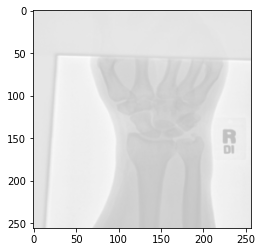

Predicted Image: 


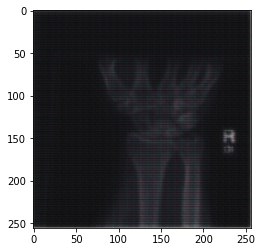

Dice Coefficient Values between predicted and actual Maks is:  tf.Tensor(0.4035864821491937, shape=(), dtype=float64)
Actual Image: 


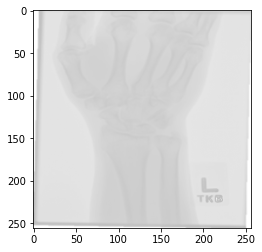

Predicted Image: 


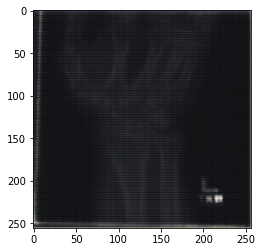

Dice Coefficient Values between predicted and actual Maks is:  tf.Tensor(0.4035864821491937, shape=(), dtype=float64)
Actual Image: 


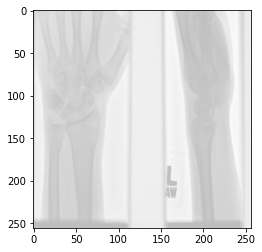

Predicted Image: 


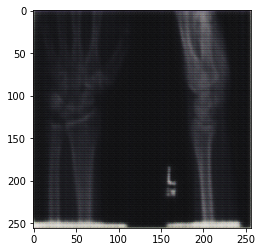

Dice Coefficient Values between predicted and actual Maks is:  tf.Tensor(0.4035864821491937, shape=(), dtype=float64)
Actual Image: 


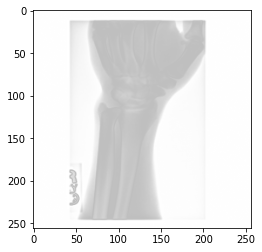

Predicted Image: 


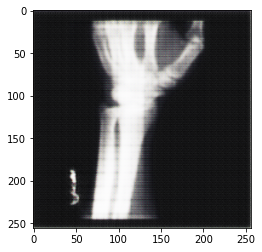

Dice Coefficient Values between predicted and actual Maks is:  tf.Tensor(0.4035864821491937, shape=(), dtype=float64)
Actual Image: 


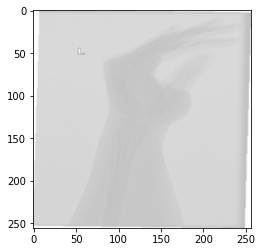

Predicted Image: 


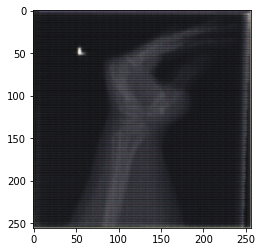

Dice Coefficient Values between predicted and actual Maks is:  tf.Tensor(0.4035864821491937, shape=(), dtype=float64)
Actual Image: 


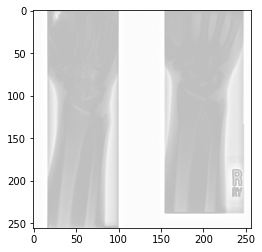

Predicted Image: 


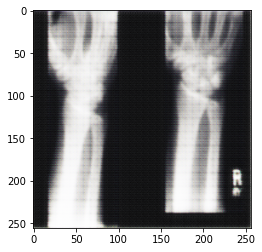

Dice Coefficient Values between predicted and actual Maks is:  tf.Tensor(0.4035864821491937, shape=(), dtype=float64)
Actual Image: 


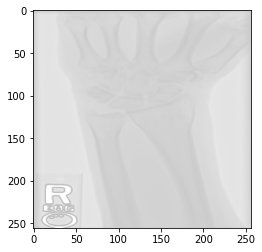

Predicted Image: 


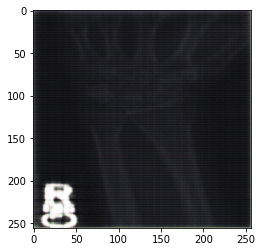

Dice Coefficient Values between predicted and actual Maks is:  tf.Tensor(0.4035864821491937, shape=(), dtype=float64)
Actual Image: 


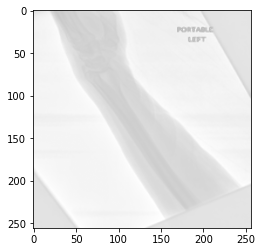

Predicted Image: 


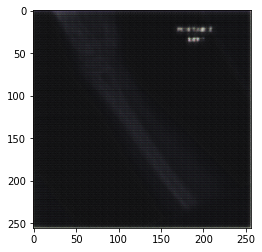

Dice Coefficient Values between predicted and actual Maks is:  tf.Tensor(0.4035864821491937, shape=(), dtype=float64)
Actual Image: 


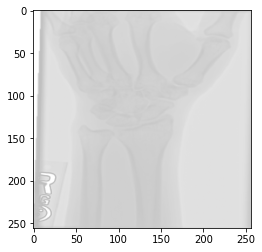

Predicted Image: 


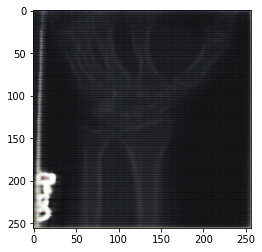

Dice Coefficient Values between predicted and actual Maks is:  tf.Tensor(0.4035864821491937, shape=(), dtype=float64)
Actual Image: 


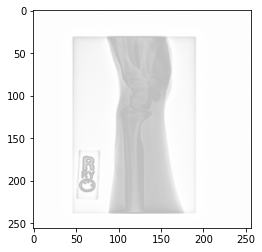

Predicted Image: 


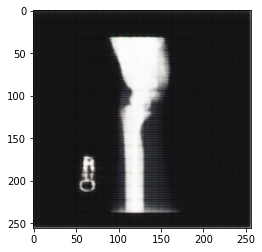

Dice Coefficient Values between predicted and actual Maks is:  tf.Tensor(0.4035864821491937, shape=(), dtype=float64)
Actual Image: 


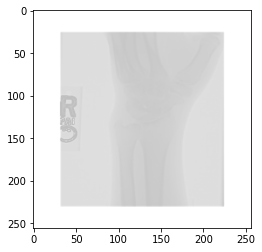

Predicted Image: 


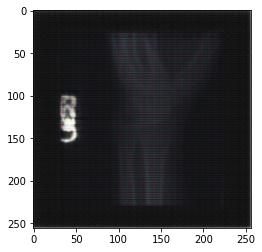

Dice Coefficient Values between predicted and actual Maks is:  tf.Tensor(0.4035864821491937, shape=(), dtype=float64)
Actual Image: 


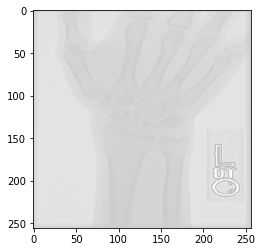

Predicted Image: 


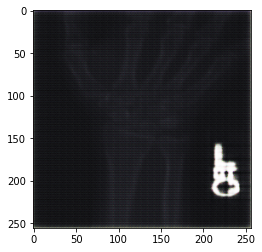

Dice Coefficient Values between predicted and actual Maks is:  tf.Tensor(0.4035864821491937, shape=(), dtype=float64)
Actual Image: 


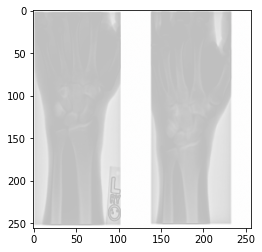

Predicted Image: 


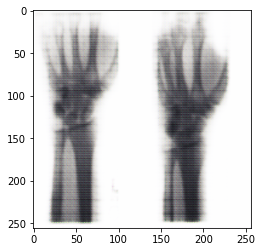

Dice Coefficient Values between predicted and actual Maks is:  tf.Tensor(0.4035864821491937, shape=(), dtype=float64)
Actual Image: 


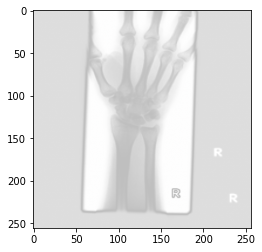

Predicted Image: 


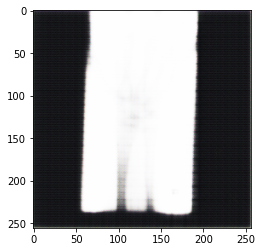

Dice Coefficient Values between predicted and actual Maks is:  tf.Tensor(0.4035864821491937, shape=(), dtype=float64)
Actual Image: 


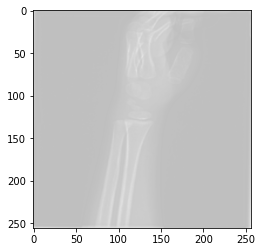

Predicted Image: 


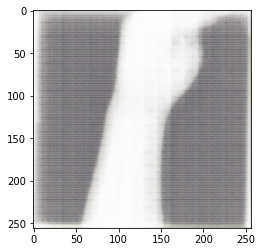

Dice Coefficient Values between predicted and actual Maks is:  tf.Tensor(0.4035864821491937, shape=(), dtype=float64)
Actual Image: 


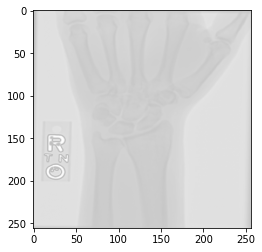

Predicted Image: 


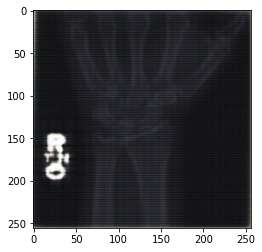

Dice Coefficient Values between predicted and actual Maks is:  tf.Tensor(0.4035864821491937, shape=(), dtype=float64)
Actual Image: 


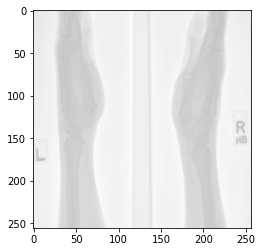

Predicted Image: 


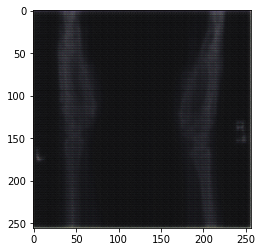

Dice Coefficient Values between predicted and actual Maks is:  tf.Tensor(0.4035864821491937, shape=(), dtype=float64)
Actual Image: 


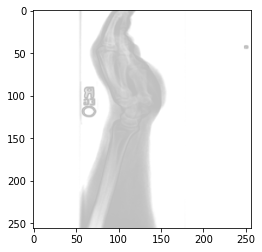

Predicted Image: 


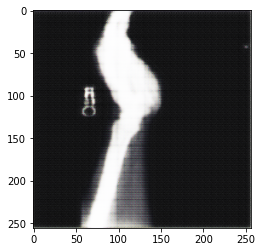

Dice Coefficient Values between predicted and actual Maks is:  tf.Tensor(0.4035864821491937, shape=(), dtype=float64)
Actual Image: 


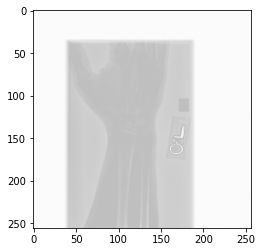

Predicted Image: 


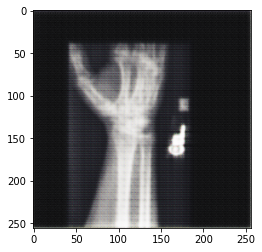

Dice Coefficient Values between predicted and actual Maks is:  tf.Tensor(0.4035864821491937, shape=(), dtype=float64)
Actual Image: 


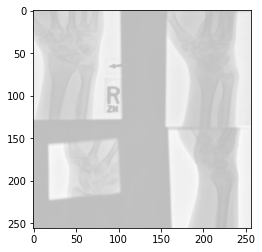

Predicted Image: 


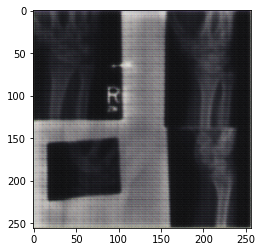

Dice Coefficient Values between predicted and actual Maks is:  tf.Tensor(0.4035864821491937, shape=(), dtype=float64)
Actual Image: 


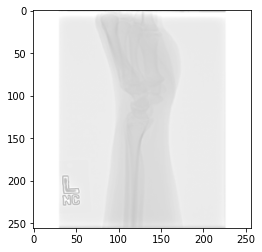

Predicted Image: 


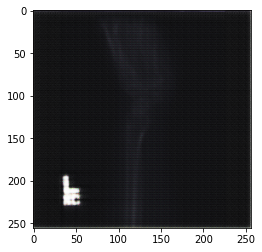

Dice Coefficient Values between predicted and actual Maks is:  tf.Tensor(0.4035864821491937, shape=(), dtype=float64)
Actual Image: 


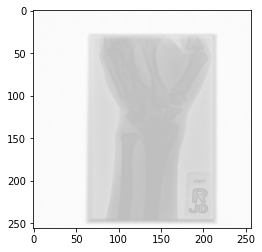

Predicted Image: 


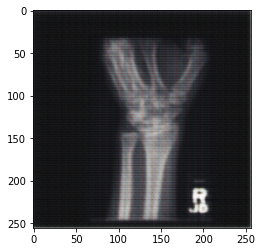

Dice Coefficient Values between predicted and actual Maks is:  tf.Tensor(0.4035864821491937, shape=(), dtype=float64)
Actual Image: 


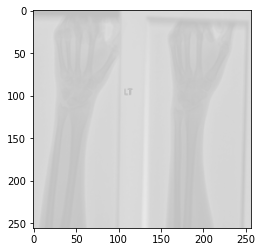

Predicted Image: 


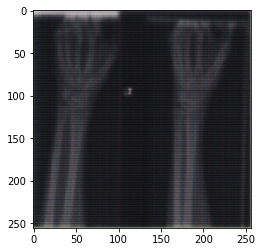

Dice Coefficient Values between predicted and actual Maks is:  tf.Tensor(0.4035864821491937, shape=(), dtype=float64)
Actual Image: 


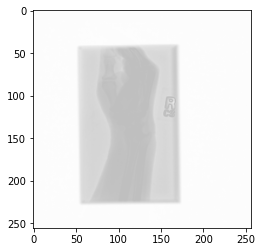

Predicted Image: 


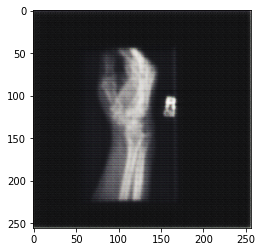

Dice Coefficient Values between predicted and actual Maks is:  tf.Tensor(0.4035864821491937, shape=(), dtype=float64)
Actual Image: 


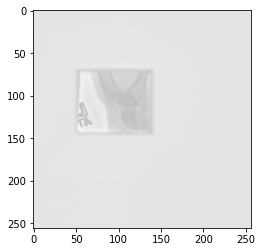

Predicted Image: 


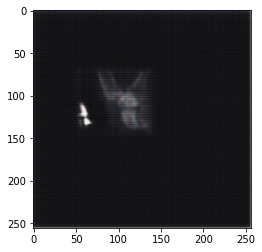

Dice Coefficient Values between predicted and actual Maks is:  tf.Tensor(0.4035864821491937, shape=(), dtype=float64)
Actual Image: 


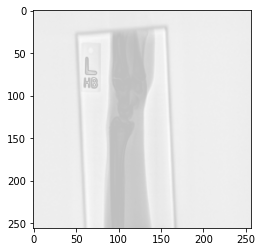

Predicted Image: 


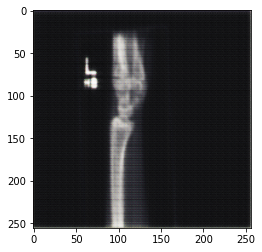

Dice Coefficient Values between predicted and actual Maks is:  tf.Tensor(0.4035864821491937, shape=(), dtype=float64)
Actual Image: 


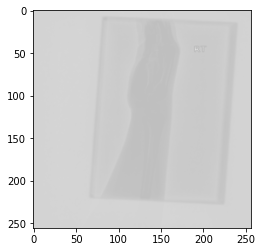

Predicted Image: 


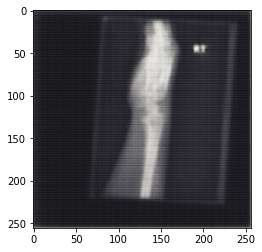

Dice Coefficient Values between predicted and actual Maks is:  tf.Tensor(0.4035864821491937, shape=(), dtype=float64)
Actual Image: 


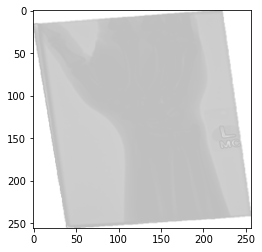

Predicted Image: 


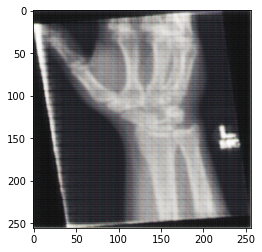

Dice Coefficient Values between predicted and actual Maks is:  tf.Tensor(0.4035864821491937, shape=(), dtype=float64)
Actual Image: 


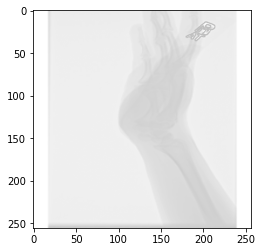

Predicted Image: 


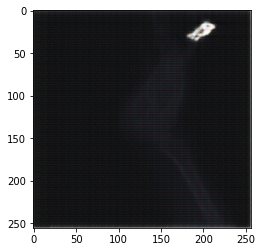

Dice Coefficient Values between predicted and actual Maks is:  tf.Tensor(0.4035864821491937, shape=(), dtype=float64)
Actual Image: 


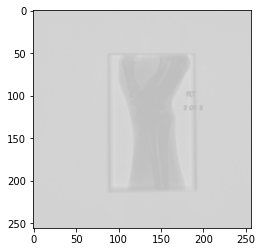

Predicted Image: 


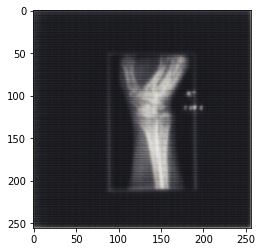

Dice Coefficient Values between predicted and actual Maks is:  tf.Tensor(0.4035864821491937, shape=(), dtype=float64)
Actual Image: 


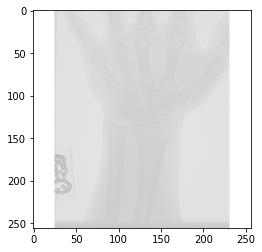

Predicted Image: 


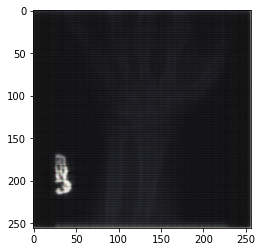

Dice Coefficient Values between predicted and actual Maks is:  tf.Tensor(0.4035864821491937, shape=(), dtype=float64)
Actual Image: 


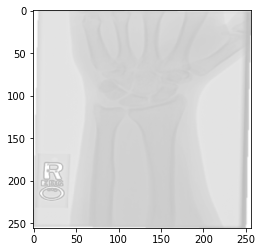

Predicted Image: 


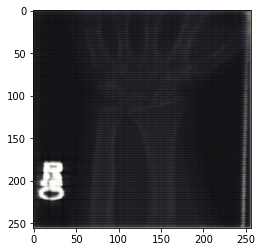

Dice Coefficient Values between predicted and actual Maks is:  tf.Tensor(0.4035864821491937, shape=(), dtype=float64)
Actual Image: 


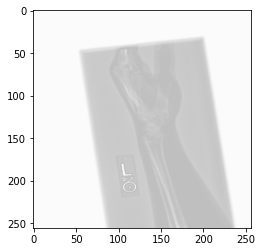

Predicted Image: 


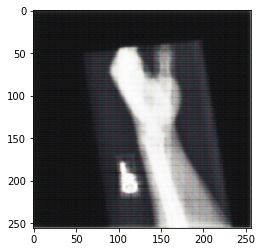

Dice Coefficient Values between predicted and actual Maks is:  tf.Tensor(0.4035864821491937, shape=(), dtype=float64)
Actual Image: 


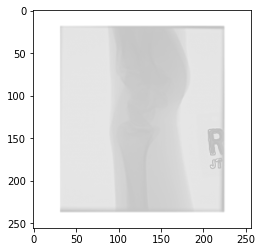

Predicted Image: 


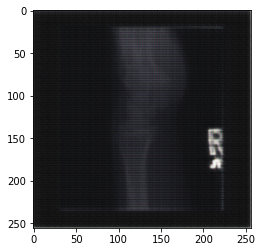

Dice Coefficient Values between predicted and actual Maks is:  tf.Tensor(0.4035864821491937, shape=(), dtype=float64)
Actual Image: 


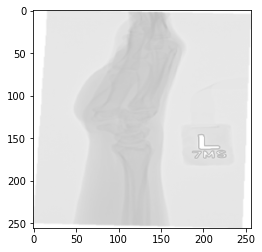

Predicted Image: 


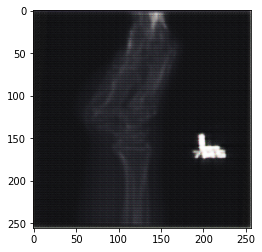

Dice Coefficient Values between predicted and actual Maks is:  tf.Tensor(0.4035864821491937, shape=(), dtype=float64)
Actual Image: 


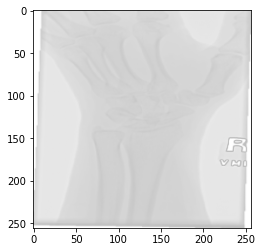

Predicted Image: 


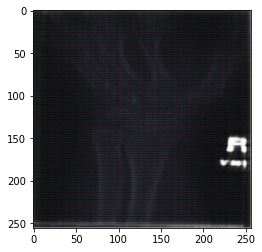

Dice Coefficient Values between predicted and actual Maks is:  tf.Tensor(0.4035864821491937, shape=(), dtype=float64)
Actual Image: 


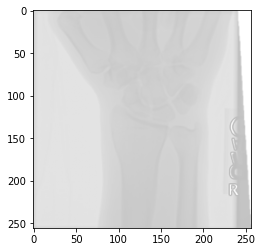

Predicted Image: 


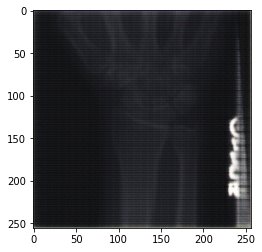

Dice Coefficient Values between predicted and actual Maks is:  tf.Tensor(0.4035864821491937, shape=(), dtype=float64)
Actual Image: 


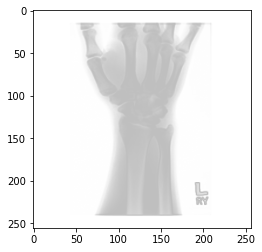

Predicted Image: 


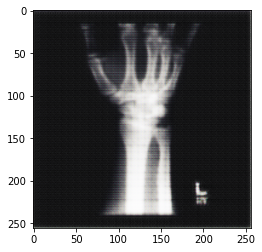

Dice Coefficient Values between predicted and actual Maks is:  tf.Tensor(0.4035864821491937, shape=(), dtype=float64)
Actual Image: 


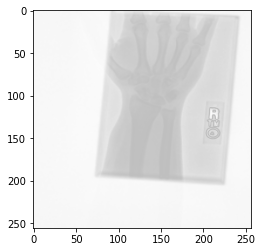

Predicted Image: 


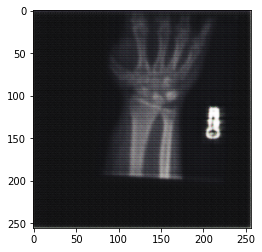

Dice Coefficient Values between predicted and actual Maks is:  tf.Tensor(0.4035864821491937, shape=(), dtype=float64)
Actual Image: 


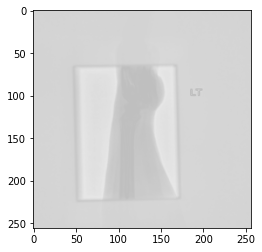

Predicted Image: 


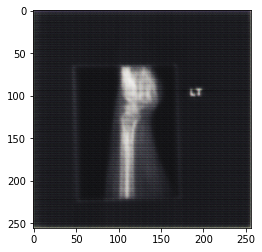

Dice Coefficient Values between predicted and actual Maks is:  tf.Tensor(0.4035864821491937, shape=(), dtype=float64)
Actual Image: 


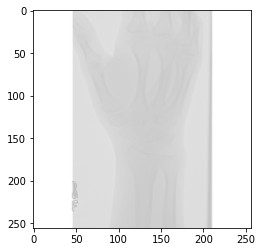

Predicted Image: 


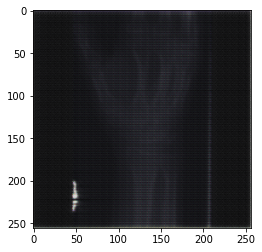

Dice Coefficient Values between predicted and actual Maks is:  tf.Tensor(0.4035864821491937, shape=(), dtype=float64)
Actual Image: 


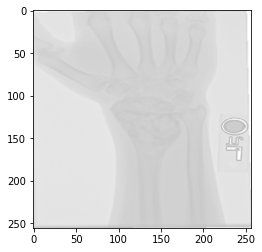

Predicted Image: 


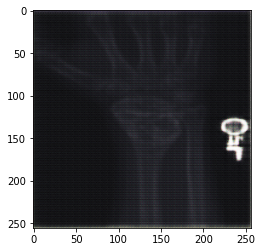

Dice Coefficient Values between predicted and actual Maks is:  tf.Tensor(0.4035864821491937, shape=(), dtype=float64)
Actual Image: 


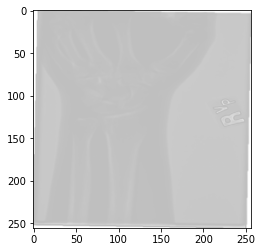

Predicted Image: 


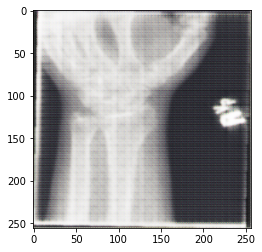

Dice Coefficient Values between predicted and actual Maks is:  tf.Tensor(0.4035864821491937, shape=(), dtype=float64)
Actual Image: 


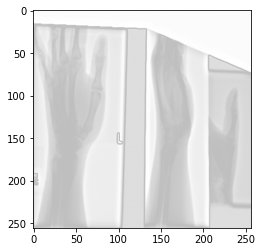

Predicted Image: 


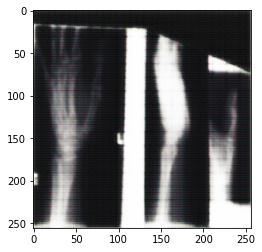

Dice Coefficient Values between predicted and actual Maks is:  tf.Tensor(0.4035864821491937, shape=(), dtype=float64)
Actual Image: 


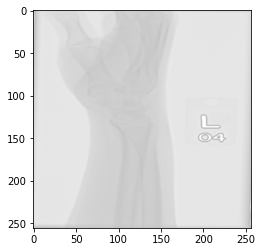

Predicted Image: 


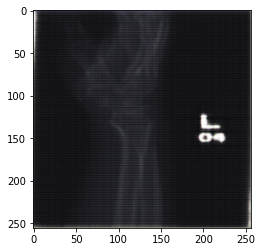

Dice Coefficient Values between predicted and actual Maks is:  tf.Tensor(0.4035864821491937, shape=(), dtype=float64)
Actual Image: 


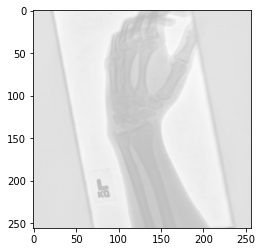

Predicted Image: 


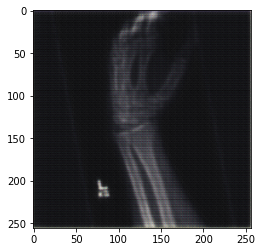

Dice Coefficient Values between predicted and actual Maks is:  tf.Tensor(0.4035864821491937, shape=(), dtype=float64)
Actual Image: 


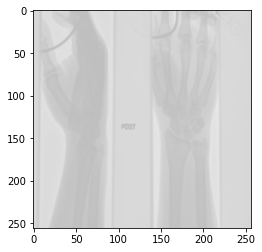

Predicted Image: 


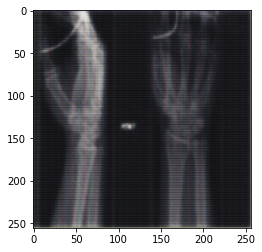

Dice Coefficient Values between predicted and actual Maks is:  tf.Tensor(0.4035864821491937, shape=(), dtype=float64)
Actual Image: 


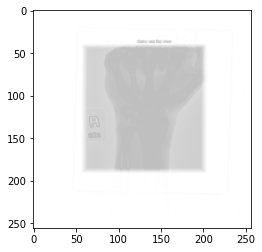

Predicted Image: 


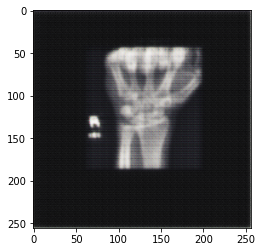

Dice Coefficient Values between predicted and actual Maks is:  tf.Tensor(0.4035864821491937, shape=(), dtype=float64)
Actual Image: 


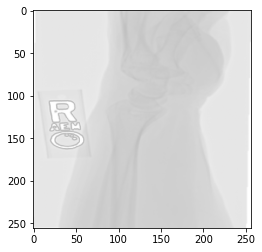

Predicted Image: 


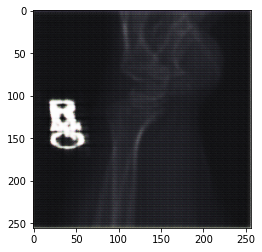

Dice Coefficient Values between predicted and actual Maks is:  tf.Tensor(0.4035864821491937, shape=(), dtype=float64)
Actual Image: 


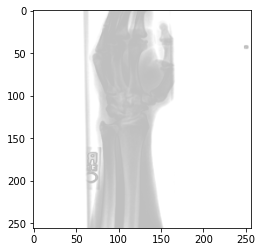

Predicted Image: 


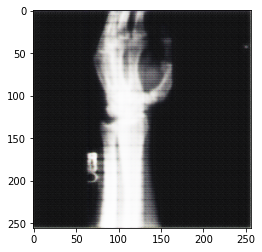

Dice Coefficient Values between predicted and actual Maks is:  tf.Tensor(0.4035864821491937, shape=(), dtype=float64)
Actual Image: 


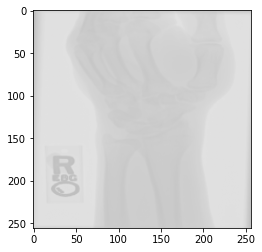

Predicted Image: 


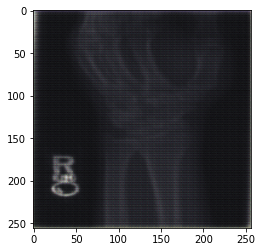

Dice Coefficient Values between predicted and actual Maks is:  tf.Tensor(0.4035864821491937, shape=(), dtype=float64)
Actual Image: 


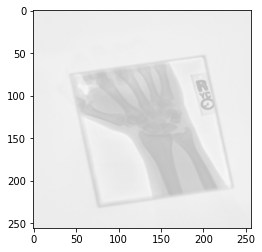

Predicted Image: 


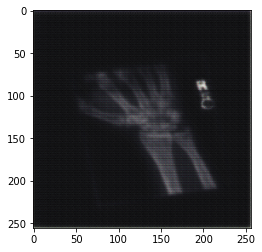

Dice Coefficient Values between predicted and actual Maks is:  tf.Tensor(0.4035864821491937, shape=(), dtype=float64)
Actual Image: 


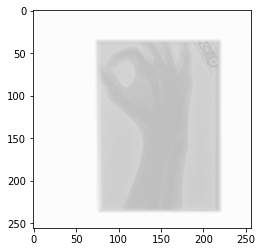

Predicted Image: 


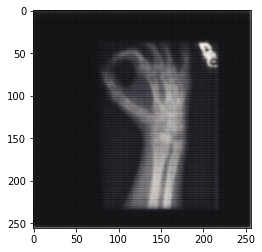

Dice Coefficient Values between predicted and actual Maks is:  tf.Tensor(0.4035864821491937, shape=(), dtype=float64)
Actual Image: 


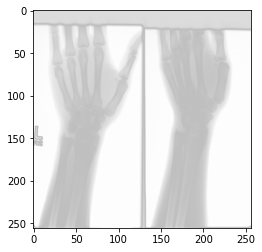

Predicted Image: 


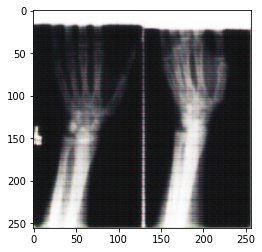

Dice Coefficient Values between predicted and actual Maks is:  tf.Tensor(0.4035864821491937, shape=(), dtype=float64)
Actual Image: 


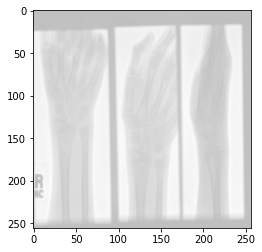

Predicted Image: 


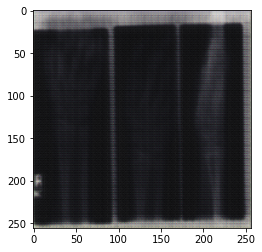

Dice Coefficient Values between predicted and actual Maks is:  tf.Tensor(0.4035864821491937, shape=(), dtype=float64)
Actual Image: 


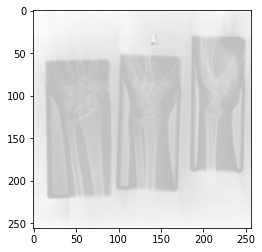

Predicted Image: 


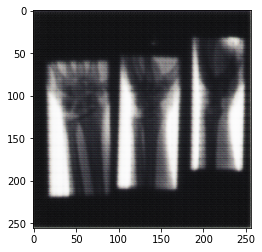

Dice Coefficient Values between predicted and actual Maks is:  tf.Tensor(0.4035864821491937, shape=(), dtype=float64)
Actual Image: 


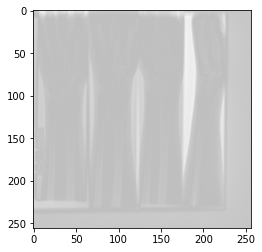

Predicted Image: 


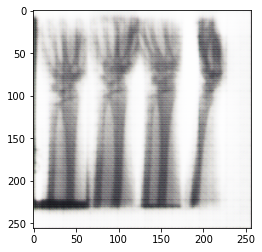

Dice Coefficient Values between predicted and actual Maks is:  tf.Tensor(0.4035864821491937, shape=(), dtype=float64)
Actual Image: 


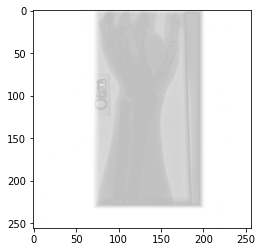

Predicted Image: 


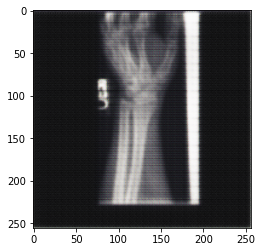

Dice Coefficient Values between predicted and actual Maks is:  tf.Tensor(0.4035864821491937, shape=(), dtype=float64)
Actual Image: 


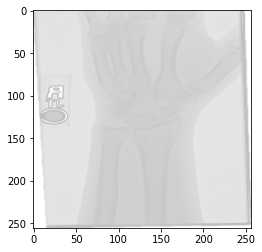

Predicted Image: 


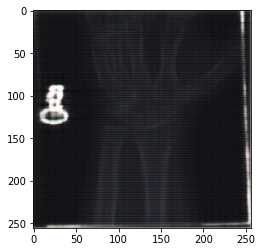

Dice Coefficient Values between predicted and actual Maks is:  tf.Tensor(0.4035864821491937, shape=(), dtype=float64)
Actual Image: 


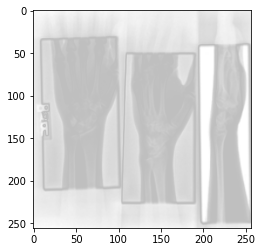

Predicted Image: 


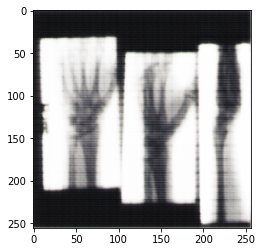

Dice Coefficient Values between predicted and actual Maks is:  tf.Tensor(0.4035864821491937, shape=(), dtype=float64)
Actual Image: 


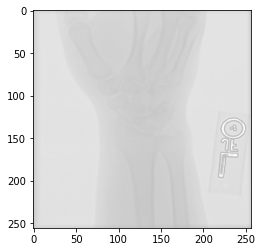

Predicted Image: 


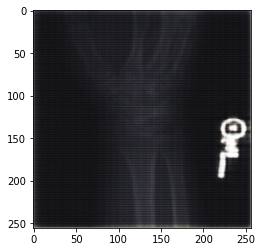

Dice Coefficient Values between predicted and actual Maks is:  tf.Tensor(0.4035864821491937, shape=(), dtype=float64)
Actual Image: 


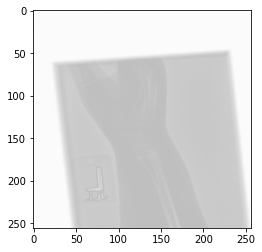

Predicted Image: 


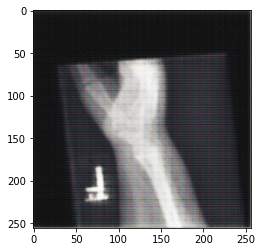

Dice Coefficient Values between predicted and actual Maks is:  tf.Tensor(0.4035864821491937, shape=(), dtype=float64)
Actual Image: 


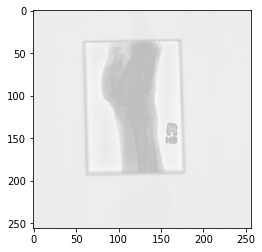

Predicted Image: 


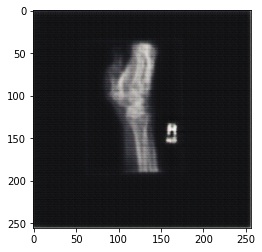

Dice Coefficient Values between predicted and actual Maks is:  tf.Tensor(0.4035864821491937, shape=(), dtype=float64)
Actual Image: 


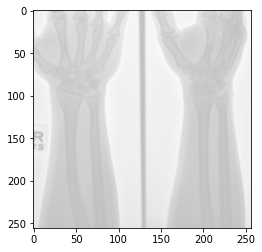

Predicted Image: 


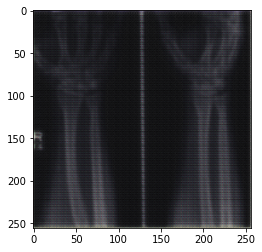

Dice Coefficient Values between predicted and actual Maks is:  tf.Tensor(0.4035864821491937, shape=(), dtype=float64)
Actual Image: 


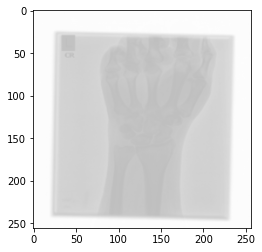

Predicted Image: 


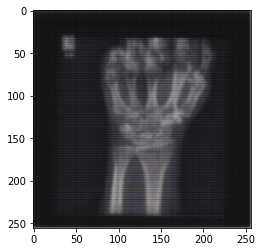

Dice Coefficient Values between predicted and actual Maks is:  tf.Tensor(0.4035864821491937, shape=(), dtype=float64)
Actual Image: 


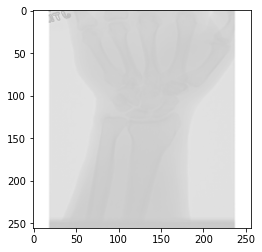

Predicted Image: 


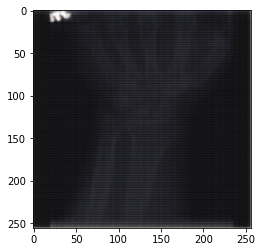

Dice Coefficient Values between predicted and actual Maks is:  tf.Tensor(0.4035864821491937, shape=(), dtype=float64)
Actual Image: 


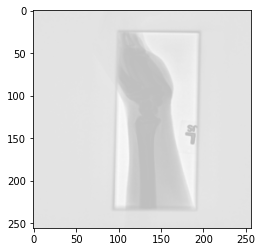

Predicted Image: 


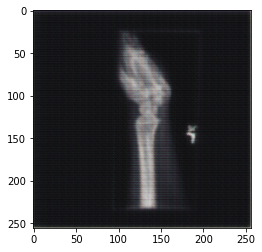

Dice Coefficient Values between predicted and actual Maks is:  tf.Tensor(0.4035864821491937, shape=(), dtype=float64)
Actual Image: 


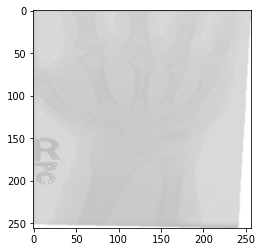

Predicted Image: 


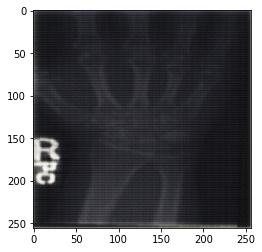

Dice Coefficient Values between predicted and actual Maks is:  tf.Tensor(0.4035864821491937, shape=(), dtype=float64)
Actual Image: 


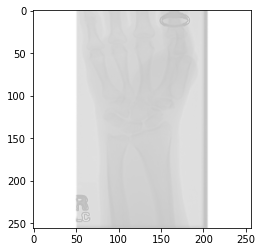

Predicted Image: 


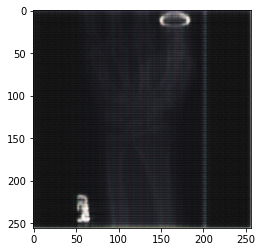

Dice Coefficient Values between predicted and actual Maks is:  tf.Tensor(0.4035864821491937, shape=(), dtype=float64)
Actual Image: 


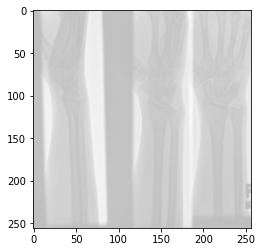

Predicted Image: 


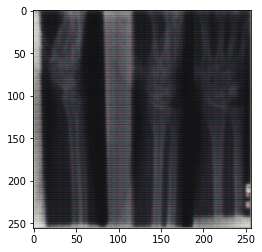

Dice Coefficient Values between predicted and actual Maks is:  tf.Tensor(0.4035864821491937, shape=(), dtype=float64)


In [14]:
##################### Showing Negative Bone Actual and Predicted Images #####################

for i in range(negative_test_img_bone_array.shape[0]):

  print("Actual Image: ")
  plt.imshow (negative_test_img_bone_array[i])
  plt.show()
  print("Predicted Image: ")
  plt.imshow (output_negative[i])
  plt.show()

  tmp_dice_coeff = dice_coeff (negative_test_img_bone_array, output_negative)
  print("Dice Coefficient Values between predicted and actual Maks is: ", tmp_dice_coeff )
  
  #intersaction = np.logical_and(negative_test_img_bone_array, output_negative)
  #union = np.logical_or(negative_test_img_bone_array, output_negative)
  #iou_score = np.sum(intersaction) / np.sum(union)
  #print("IOU score is: ", iou_score)



Total Number of Test Images are :  99


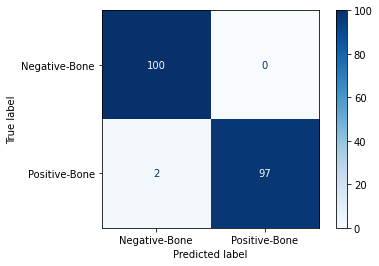

In [15]:
####################### Showing Visualizations of Confusion Matrix ########################
from sklearn.metrics import ConfusionMatrixDisplay
from sklearn.metrics import confusion_matrix
import matplotlib.pyplot as plt

print("Total Number of Test Images are : ", len(actual_test_labels))
labels = ["Negative-Bone", "Positive-Bone"]

all_test_labels = np.concatenate([actual_test_labels,actual_test_labels_negative], axis=-1)
all_predicted_classes = np.concatenate([predicted_class ,predicted_class_negative], axis=-1)

cm = confusion_matrix(all_test_labels, all_predicted_classes)

disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=labels)

disp.plot(cmap=plt.cm.Blues)
plt.show()


Showing Predicted Probabilities: 
[  1.           1.           1.           1.           1.
   1.           1.           1.           1.           1.
   1.           1.           1.           1.           1.
   1.           1.           1.           1.           1.
   1.           1.           1.           1.           1.
   1.           1.           1.           1.           1.
   1.           1.           1.           1.           1.
   0.5287162    1.           1.           1.           1.
   1.           1.           1.           1.           1.
   1.           1.           1.           1.           1.
   1.           1.           1.           1.           1.
   1.           1.           1.           1.           0.51702017
   1.           1.           1.           1.           1.
   1.           1.           1.           1.           1.
   1.           1.           1.           1.           1.
   1.           1.           1.           1.           1.
   1.           1.           1

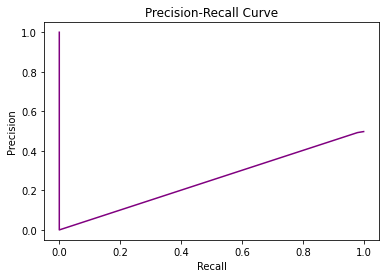

Showing Precision: 
0.9901960784313726
Showing Recall: 
0.9898989898989898
Showing F1 Score : 
0.9899474641341686


In [16]:
############################  Showing Precision, Recall , F1-Score and ROC curve ####################
from sklearn.metrics import accuracy_score, f1_score, precision_score, recall_score, classification_report, confusion_matrix

all_mse = np.concatenate([mse_loses, mse_loses_negative], axis=-1)

mse_losses_numpy = all_mse
mse_losses_numpy [all_predicted_classes] = 1.0
mse_losses_numpy [~all_predicted_classes] = (mse_losses_numpy [~all_predicted_classes]) / 100 
print("Showing Predicted Probabilities: ")
print(mse_losses_numpy)


from sklearn.metrics import precision_recall_curve

#calculate precision and recall
precision, recall, thresholds = precision_recall_curve(all_test_labels, mse_losses_numpy)

#create precision recall curve
fig, ax = plt.subplots()
ax.plot(recall, precision, color='purple')

#add axis labels to plot
ax.set_title('Precision-Recall Curve')
ax.set_ylabel('Precision')
ax.set_xlabel('Recall')

#display plot
plt.show()


print("Showing Precision: ")
print(precision_score(all_test_labels, all_predicted_classes, average="macro"))
print("Showing Recall: ")
print(recall_score(all_test_labels, all_predicted_classes, average="macro"))    
print("Showing F1 Score : ")
print(f1_score(all_test_labels, all_predicted_classes, average="macro"))

Showing 1 Negative Bone Image Added: 


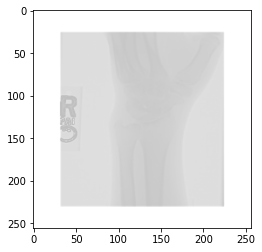

Adding 50 Positive Bone images in the Testing Array:
Showing 1 Positive Bone Image Added: 


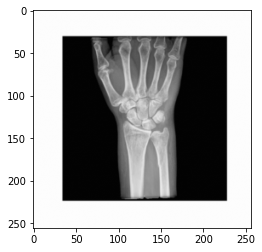

(100, 256, 256)
Individual Losses Between Actual Bone images and Predicted Bone Images:  tf.Tensor(
[ 9095.934     9790.713    10683.337    12960.229    10280.759
 11143.709    10549.387    10337.633     5895.8135   11188.251
 10782.068    11166.413     9796.336    11469.484    10487.57
  5138.283    10936.639    11340.828     8911.778     9381.657
 10688.67      9637.814     9565.603     4310.0303    4976.8496
 10552.902     9301.24      8699.6875   11249.039    12143.645
 11022.982    10414.969    10548.99     11533.0625    9564.07
  9528.352    10242.527    11981.8125   10056.122    12321.165
 11605.922    10477.734     4623.171     7013.0605    4937.143
  9967.916    11640.449    12135.588    10508.823     8588.02
    31.335045    18.894688    23.541204    25.689222    26.140095
    47.08596     27.042332    28.425713    32.378654    33.522427
    37.25219     21.67473     24.2401      30.873156    27.645704
    23.099014    31.33418     44.70977     20.694237    21.118462
    36.5

In [17]:
######################### Adding 50 Positive and 50 Negative Bone Images and Finding Accuracy on it ##################

############ Defining an array with 100 images #######################
test_img_bone_array = np.zeros((100,256,256,4))

############### Adding 50 Negative Bone Testing images to the Array ############

testfolder_directory = "{}/Bone_Fracture/Negative/".format(directory_path)
all_negative_bone_images_paths = glob.glob('{}/*.png'.format(testfolder_directory) )

for i, tmp_path in enumerate(all_negative_bone_images_paths[:50]):

  # print("Adding {} Negative Bone Image to Numpy Array".format ( os.path.basename(tmp_path)) )
  
  img = io.imread(tmp_path)
  img_resized = resize(img, (256,256,4))

  test_img_bone_array[i] = img_resized

print("Showing 1 Negative Bone Image Added: ")
plt.imshow(test_img_bone_array[40])
plt.show()
############### Adding 50 Positive Bone Testing images to the Array ############

print("Adding 50 Positive Bone images in the Testing Array:")
test_img_bone_array[50:100] = X_test[:50]

print("Showing 1 Positive Bone Image Added: ")
plt.imshow(test_img_bone_array[55])
plt.show()

##################### Finding Prediction on Test Image ########
output = autoencoder.predict(test_img_bone_array)


mse_loses = tf.keras.metrics.mean_squared_error(test_img_bone_array, output)
print(mse_loses.shape)
mse_loses= tf.reduce_sum(mse_loses, axis=-1)
mse_loses= tf.reduce_sum(mse_loses, axis=-1)
print("Individual Losses Between Actual Bone images and Predicted Bone Images: ", mse_loses)

mse_loss_threshod = 200

predicted_class = mse_loses <= mse_loss_threshod

print(predicted_class)


actula_test_labels = np.zeros((100,))
actula_test_labels[50:100] = 1

from sklearn.metrics import accuracy_score

model_accuracy = accuracy_score(actula_test_labels, predicted_class)
print("Auto-Encoder Model Accuracy on Test Images is : ", model_accuracy, " OR ", model_accuracy*100, "%" )